# Gene Expression Clustering Analysis


Human ability to gather genome-wide expression data has far outstripped our ability to process the raw data. We can distill the data down to a more comprehensible level by subdividing the genes into a smaller number of categories and then analyzing those. This is where clustering comes in. A large review of clustering algorithms can be found in [1].

The goal of clustering is to subdivide a set of items (in our case, genes) in such a way that similar items fall into the same cluster, whereas dissimilar items fall in different clusters.

This project consists on the exploration of different clustering techniques to a microarray study of gene expression in yeast published in [2]. The authors used DNA microarrays to study temporal gene expression of almost all genes in Saccharomyces cerevisiae during the metabolic shift from fermentation to respiration. Expression levels were measured at seven time points during the diauxic shift.

In the reference [3] a comparison of different well known and more advanced clustering algorithms is carried out over this same gene expression microarray reported in [2].

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering, Birch
from sklearn.mixture import GaussianMixture as GMM
from sklearn.metrics import make_scorer, accuracy_score
from sklearn.metrics import calinski_harabasz_score 
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.pipeline import Pipeline
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import Normalizer
import warnings
import math

warnings.filterwarnings('ignore')
%matplotlib inline

## 1. Preprocessing Data and Quick Analysis

### 1.1 Loading Data

The data is provided in the “data” folder. There are three .csv files:
- **genes.csv** indicates the name for all 6400 genes in the microarray
- **times.csv** indicates the seven time steps times at which the expression levels were measured
- **yeastvalues.csv** contains the expression values (log2 of ratio of CH2DN_MEAN and CH1DN_MEAN) from the seven time steps in the experiment

In [2]:
data = pd.read_csv('./data/yeastvalues.csv',header=None,delimiter = ';', decimal= ',', na_values='') 
gene_names = pd.read_csv('./data/genes.csv',header=None, names=["GENES"])
time_points = pd.read_csv('./data/times.csv',header=None,delimiter = ';', decimal= ',', na_values='', dtype=float)

Firstly, we will set the names of each features column. As data corresponds to different timepoints, we will directly use the **time_points** file to set the columns name in the main dataframe:

In [3]:
x_axis = list(time_points.loc[0])
time_points.values

array([[ 0. ,  9.5, 11.5, 13.5, 15.5, 18.5, 20.5]])

In [4]:
X = data.values[:,:].astype(float)
data = pd.DataFrame(X, columns=list(time_points.loc[0]))

Secondly, we will assign the gene name to each entry:

In [5]:
data = pd.concat([gene_names, data], axis=1)
data.head()

,GENES,0.0,9.5,11.5,13.5,15.5,18.5,20.5
0,'GENOMIC 1X',0.165,0.272,0.046,0.429,0.143,-0.211,0.183
1,'GENOMIC 0.5X',0.101,0.237,-0.109,0.149,0.111,-0.140,0.252
2,'GENOMIC 0.25X',0.150,0.469,-0.015,0.144,0.072,0.115,0.215
3,'EMPTY',-1.193,NaN,-0.963,-0.510,-2.392,NaN,-0.939
4,'PNCA',-0.741,0.227,-0.986,-0.048,-1.277,-0.194,NaN


Now we have our dataset in a well structurated dataframe format. Each entry has a gene name assigned and the values for each time point of the experiment. We found out that some of the entries has empty values, so let's remove them.

### 1.2 Removing entries with missing values

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6400 entries, 0 to 6399
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   GENES   6400 non-null   object 
 1   0.0     6350 non-null   float64
 2   9.5     6343 non-null   float64
 3   11.5    6345 non-null   float64
 4   13.5    6367 non-null   float64
 5   15.5    6354 non-null   float64
 6   18.5    6346 non-null   float64
 7   20.5    6360 non-null   float64
dtypes: float64(7), object(1)
memory usage: 400.1+ KB


We see there are some missing values in the dataframe. The counts for the columns do not match with the total number of entries. Let's drop any missing value for any of the columns:

In [7]:
data = data.dropna()
data = data[data['GENES'] != "'EMPTY'"]
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6276 entries, 0 to 6399
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   GENES   6276 non-null   object 
 1   0.0     6276 non-null   float64
 2   9.5     6276 non-null   float64
 3   11.5    6276 non-null   float64
 4   13.5    6276 non-null   float64
 5   15.5    6276 non-null   float64
 6   18.5    6276 non-null   float64
 7   20.5    6276 non-null   float64
dtypes: float64(7), object(1)
memory usage: 441.3+ KB


In [8]:
data.head()

,GENES,0.0,9.5,11.5,13.5,15.5,18.5,20.5
0,'GENOMIC 1X',0.165,0.272,0.046,0.429,0.143,-0.211,0.183
1,'GENOMIC 0.5X',0.101,0.237,-0.109,0.149,0.111,-0.140,0.252
2,'GENOMIC 0.25X',0.150,0.469,-0.015,0.144,0.072,0.115,0.215
5,'LAMBDA',-0.351,0.425,-0.574,-0.522,0.404,0.320,0.249
6,'POLY DA',0.272,0.825,0.544,0.353,-0.659,-0.009,0.545


In [9]:
X_clean = data.values[:,1:].astype(float)

Now, we have a dataframe with clean data, containing 6276 entries with no missing values. However, this dataset includes several duplicate entries for some gene names. We will retain these duplicates to ensure we have more data, which could lead to better results.

In [10]:
sum(data['GENES'].duplicated())

98

### 1.3 Normalizing and scaling 

Let's analyze the data visually to gain insights into its distribution. We will plot the correlation between the features using a low alpha value, making it easier to detect clusters.

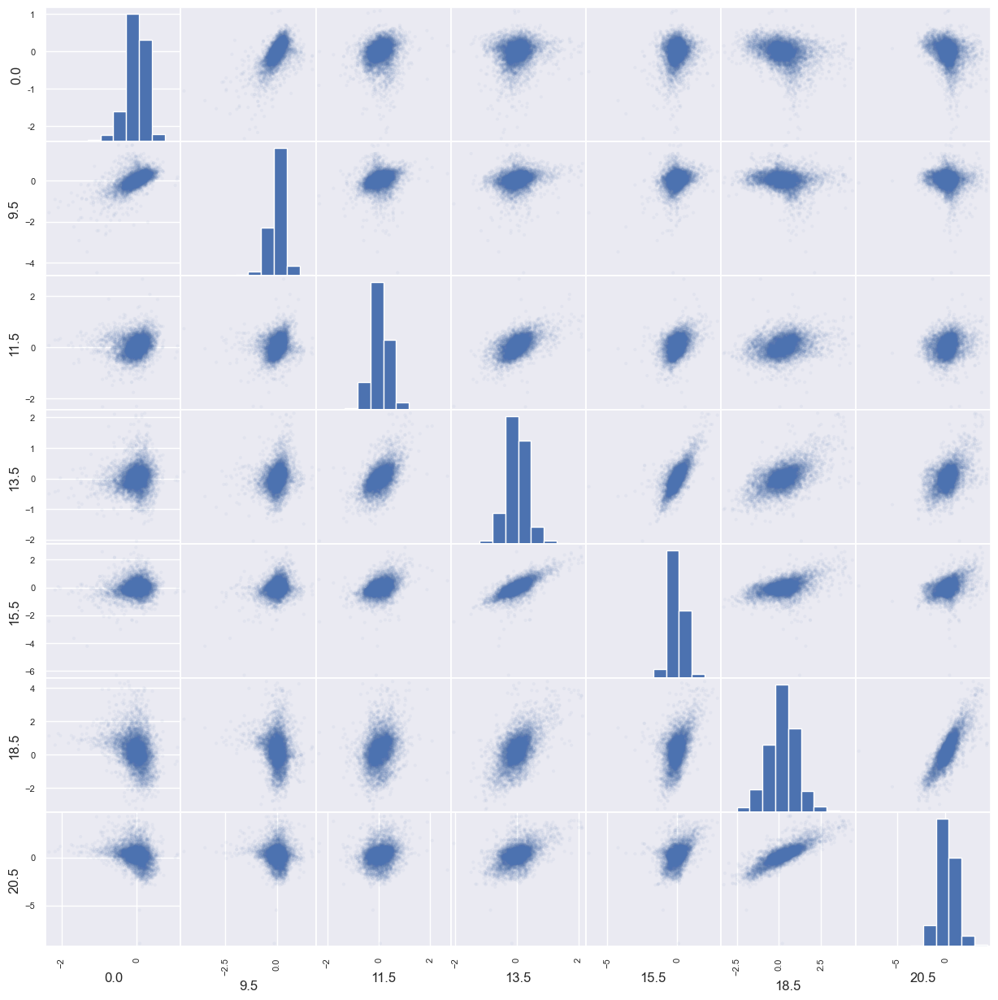

In [11]:
_ = scatter_matrix(data, figsize = (15, 15), alpha=0.05)

No clusters can be identified from this comparison. Outliers scatter the data too much, which may cause the clusters to overlap in the space. Centering and scaling the data could help make the clusters more detectable. Let's try again with normalized data:

In [12]:
normalizer = Normalizer()
X_clean_norm = normalizer.fit_transform(X_clean)

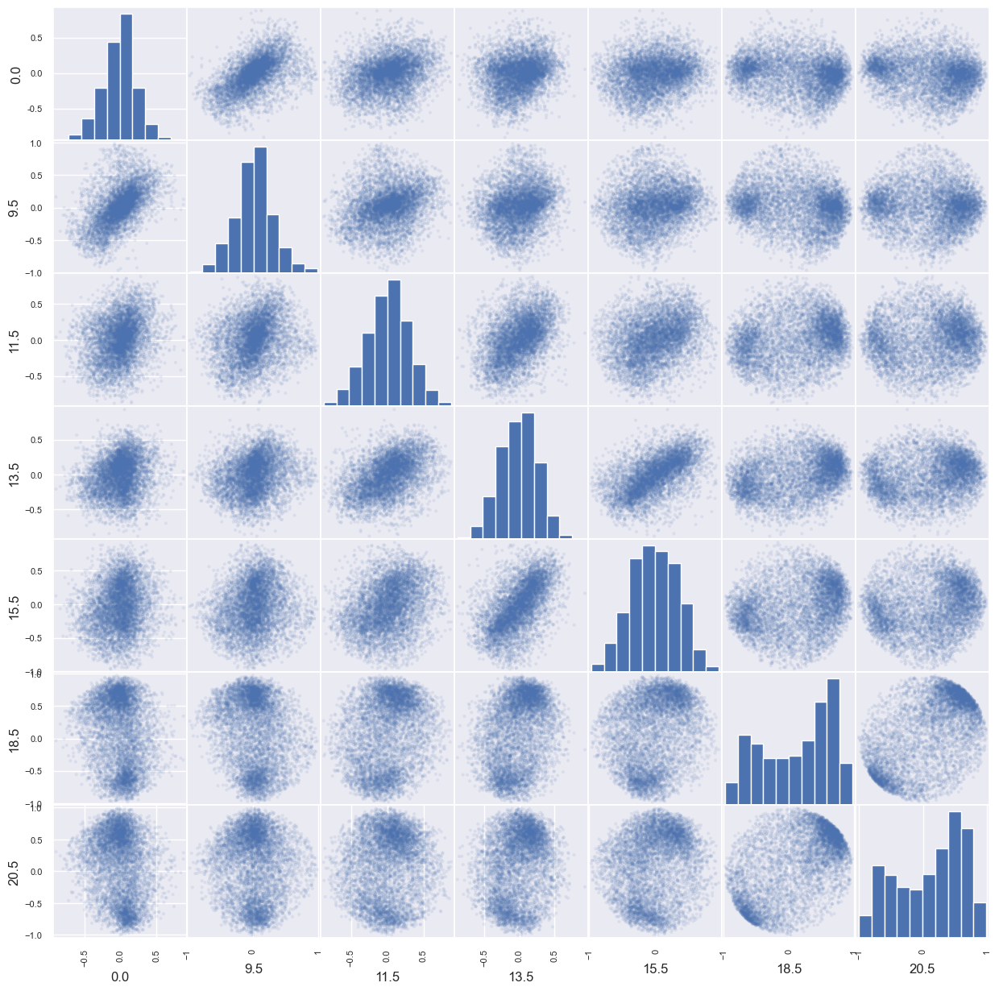

In [13]:
_ = scatter_matrix(pd.DataFrame(X_clean_norm, columns=list(time_points.loc[0])), figsize = (15, 15), alpha=0.1)

In [14]:
time_points

,0,1,2,3,4,5,6
0,0.0,9.5,11.5,13.5,15.5,18.5,20.5


Now, our plot looks better. We can see two distinct, darker areas in some of the feature correlations, especially in the plots where we correlated the values for the time points **20.5** and **18.5**. The most informative plots are those that display these two features. We also observe that the histogram for these two features resembles the composition of two Gaussian distributions.

Based on this analysis, it might make sense to run a clustering algorithm to identify just two clusters. However, let's be more precise by using the elbow method to gain a clearer insight.

### 1.4 Principal Component Analysis

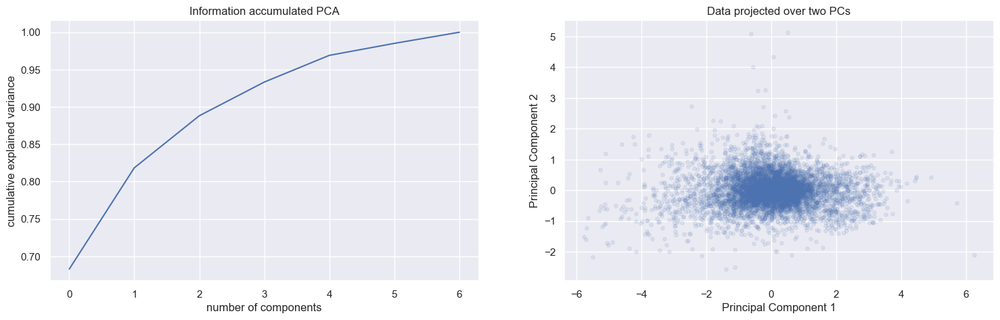

In [15]:
pca = PCA()
pca.fit(X_clean)
X_pca = pca.transform(X_clean)
var_ratio = pca.explained_variance_ratio_
pca_cumsum = np.cumsum(var_ratio)

fig = plt.figure(figsize=(18, 5))

ax = plt.subplot(1,2,1)
plt.plot(pca_cumsum)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Information accumulated PCA')

ax = plt.subplot(1,2,2)
plt.scatter(X_pca[:, 0], X_pca[:, 1], s=15, alpha=0.1)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Data projected over two PCs')
plt.show()

When plotting the two principal components for unnormalized data, no distinct clusters can be identified, only a large cluster containing the majority of the data points. It’s important to note that just one feature accounts for almost 70% of the information.

Now, let’s plot the normalized data projected onto the two principal components space:

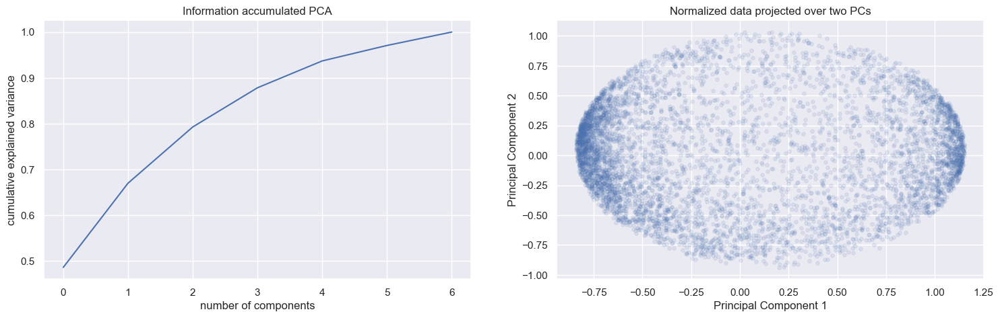

In [16]:
fig = plt.figure(figsize=(18, 5))

pca = PCA()
pca.fit(X_clean_norm)
X_norm_pca = pca.transform(X_clean_norm)
var_ratio = pca.explained_variance_ratio_
pca_cumsum = np.cumsum(var_ratio)

ax = plt.subplot(1,2,1)
plt.plot(pca_cumsum)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Information accumulated PCA')

pca.fit(X_clean_norm)
X_norm_pca = pca.transform(X_clean_norm)

ax = plt.subplot(1,2,2)
plt.scatter(X_norm_pca[:, 0], X_norm_pca[:, 1], s=15, alpha=0.1)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Normalized data projected over two PCs')
plt.show()

When plotting the normalized data over the two main PCs, we obtain a similar result to the correlation plots shown above: two polarized groups.

## 2.1 Clustering Algorithms

### 2.1.1 k-means

We have no labels for our dataset, so the number of clusters to identify is unknown. Let's implement the elbow method to get an idea of how many clusters may exist. We will assess the performance of the K-means algorithm for different numbers of clusters and choose the number that explains the most variance with the highest quality. Clusters containing between 2 and 100 genes will be analyzed.

In [17]:
# Helper functions
def kmeans_unlabeled(X, k_values):
    qmetric = calinski_harabasz_score 

    qualities = []
    inertias = []
    models = []
    
    for k in k_values:
        model = KMeans(n_clusters=k, random_state=0).fit(X)
        models.append(model)
        inertias.append(model.inertia_)
    
        if k >1:
            qualities.append(qmetric(X, model.labels_))
        else:
            qualities.append(0)
            
    best = pd.Series(qualities).idxmax()
    best_model = models[best]
    n_clusters = best_model.get_params()['n_clusters']
    
    return n_clusters, qualities, inertias, models

def plot_kmeans_unlabeled(qualities, inertias, x_axis):
    fig = plt.figure(figsize=(14,3))

    ax = plt.subplot(1,2,1)
    plt.plot(x_axis, inertias, marker='o')
    plt.xlabel('number of clusters')
    plt.title('clustering inertia')

    ax = plt.subplot(1,2,2)
    plt.plot(x_axis, qualities, marker='o')
    plt.xlabel('number of clusters')
    plt.title('clustering quality')
    plt.show()
    
def plot_pca_label(data, labels, alpha=0.1, size=1):
    f, ax = plt.subplots(6, 6, sharey=False, figsize=(17, 17))

    for i in range(0,6):
        for j in range(0,6):
            plot = ax[i][j]
            _ = plot.scatter(data[:, i], data[:, j], c=labels, s=size, cmap='viridis', alpha=alpha)

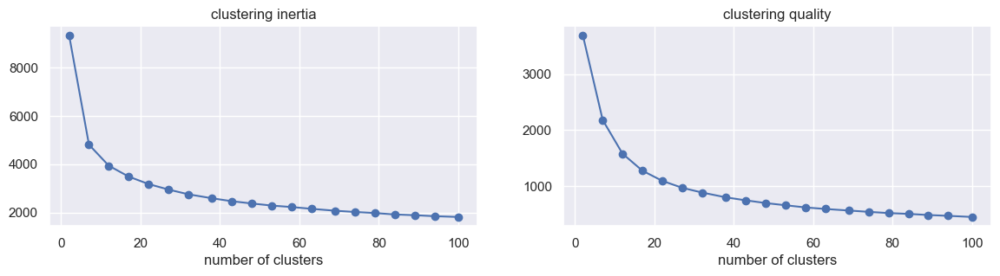

Clusters sizes analyzed: [2, 7, 12, 17, 22, 27, 32, 38, 43, 48, 53, 58, 63, 69, 74, 79, 84, 89, 94, 100]
Optimal Number of Clusters: 2


In [18]:
clusters_sizes = np.linspace(2, 100, 20, dtype=int).tolist()
results = kmeans_unlabeled(X_clean, clusters_sizes) 
plot_kmeans_unlabeled(results[1], results[2], clusters_sizes)
print('Clusters sizes analyzed:', clusters_sizes)
print("Optimal Number of Clusters: %i" %results[0])

We observe an elbow when the data is split into 2 clusters. Next, let's explore cluster sizes around this value to refine our results and obtain a more accurate estimate. We will examine cluster sizes from 1 to 30.

In [19]:
results = kmeans_unlabeled(X_clean, range(1,30))

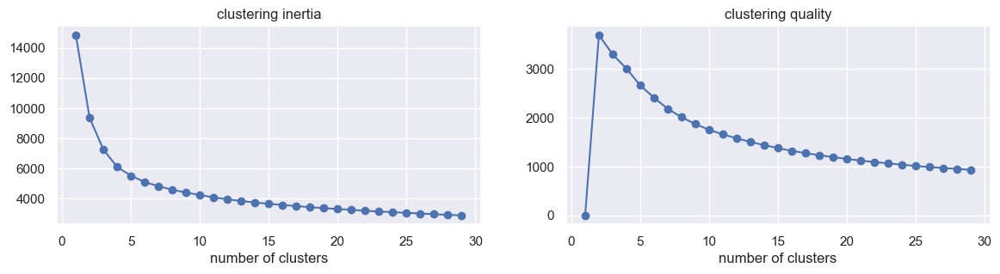

Optimal Number of Clusters: 2


In [20]:
plot_kmeans_unlabeled(results[1], results[2], range(1,30))
print("Optimal Number of Clusters: %i" %results[0])

In [21]:
results_norm = kmeans_unlabeled(X_clean_norm, range(1,30))

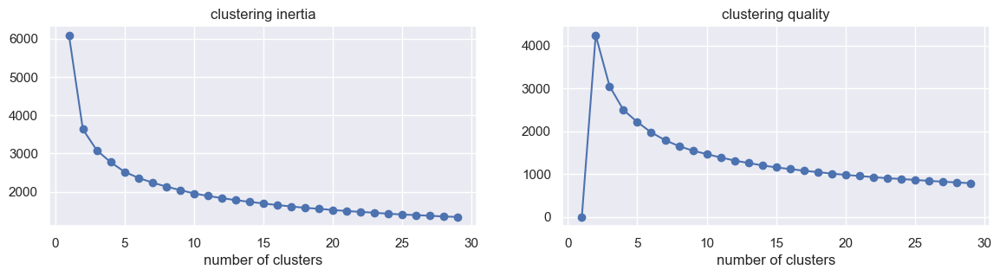

Optimal Number of Clusters when normalized data: 2


In [22]:
plot_kmeans_unlabeled(results_norm[1], results_norm[2], range(1,30))
print("Optimal Number of Clusters when normalized data: %i" %results_norm[0])

Even after analyzing all cluster sizes between 1 and 30, we obtained the same results for both unnormalized and normalized data. The best quality and inertia are achieved with 2 clusters. Although 3 and 6 clusters also appear promising, all indications point to 2 clusters, consistent with our previous analysis. Therefore, let's run the K-means algorithm with this parameter value.

Features correlation for unnormalized data:

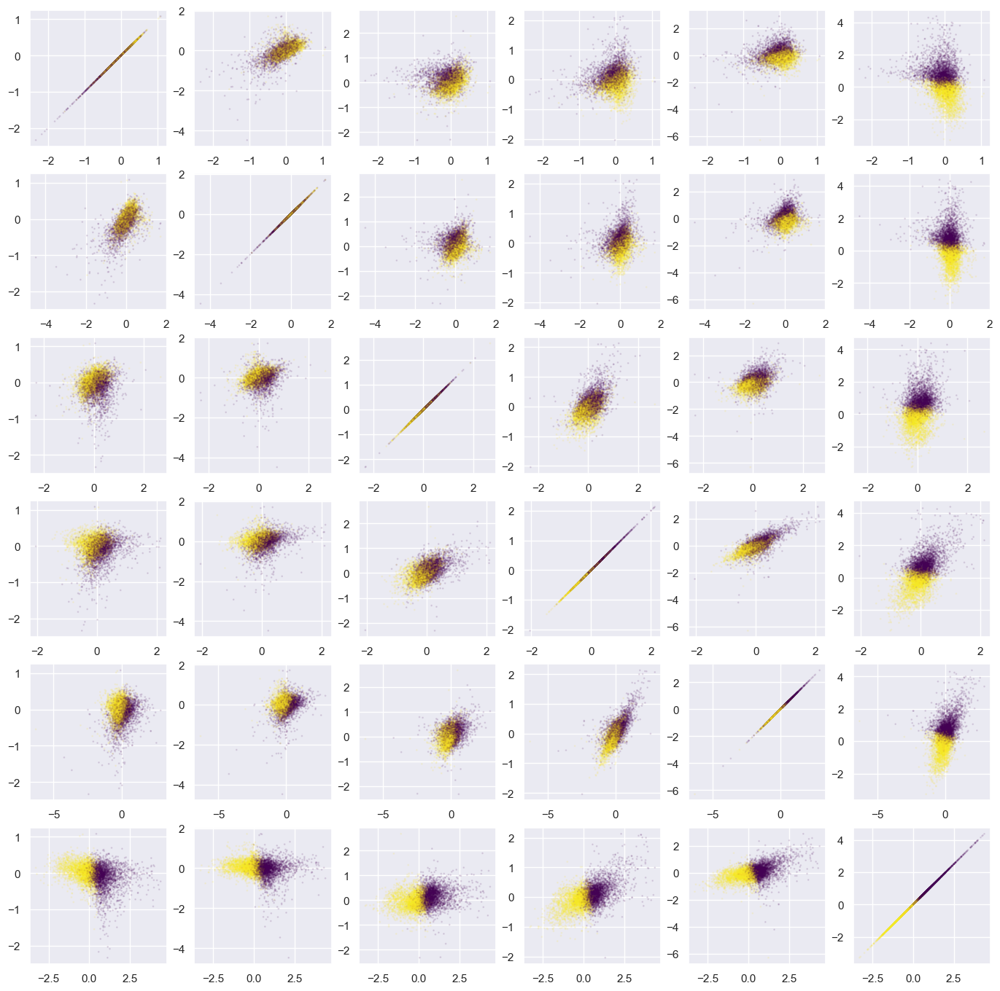

In [23]:
km = KMeans(n_clusters=2, random_state=0).fit(X_clean)
km_labels = km.predict(X_clean)
plot_pca_label(X_clean, km_labels)

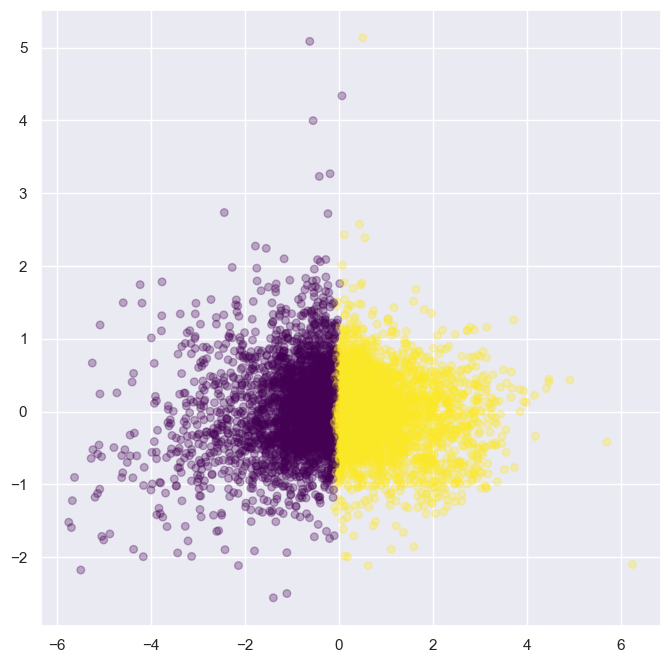

In [24]:
plt.figure(figsize=(8,8))
_ = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=km_labels, s=30, cmap='viridis', alpha=0.3)

Features correlation for normalized data:

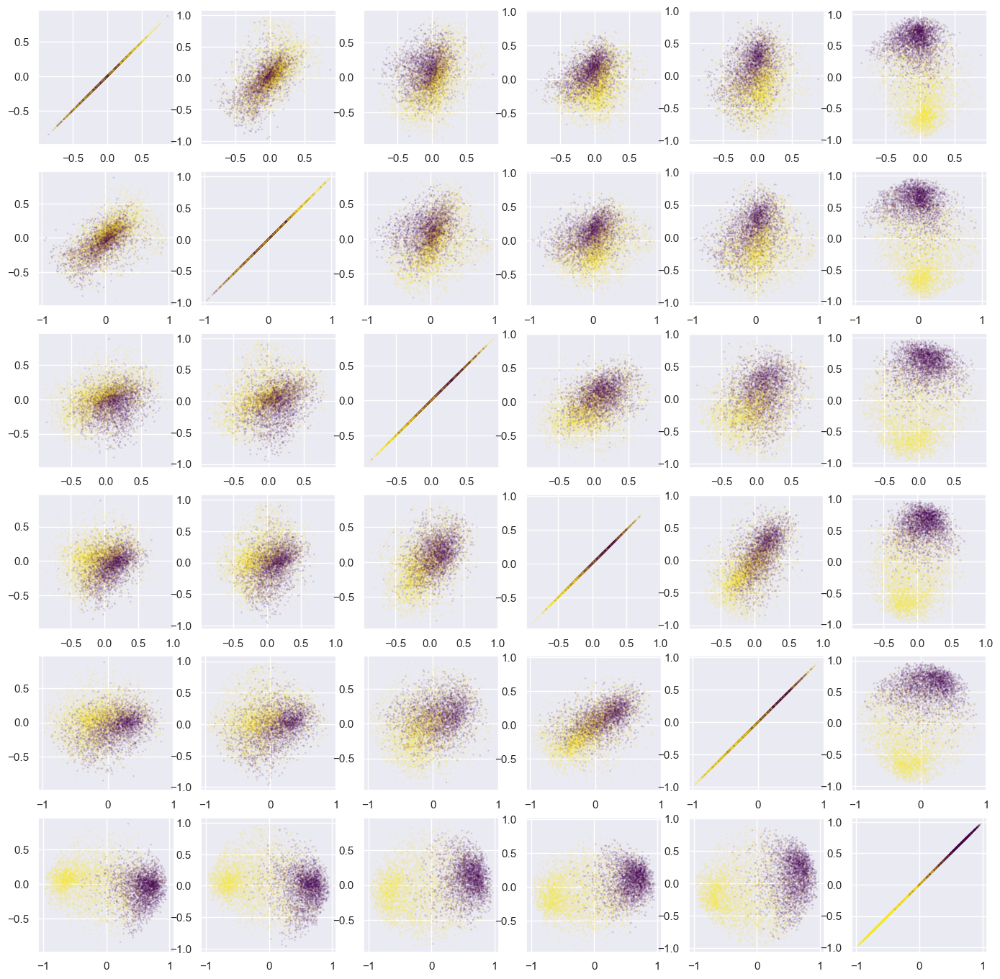

In [25]:
km = KMeans(n_clusters=2, random_state=0).fit(X_clean_norm)
km_labels_norm = km.predict(X_clean_norm)
plot_pca_label(X_clean_norm, km_labels)

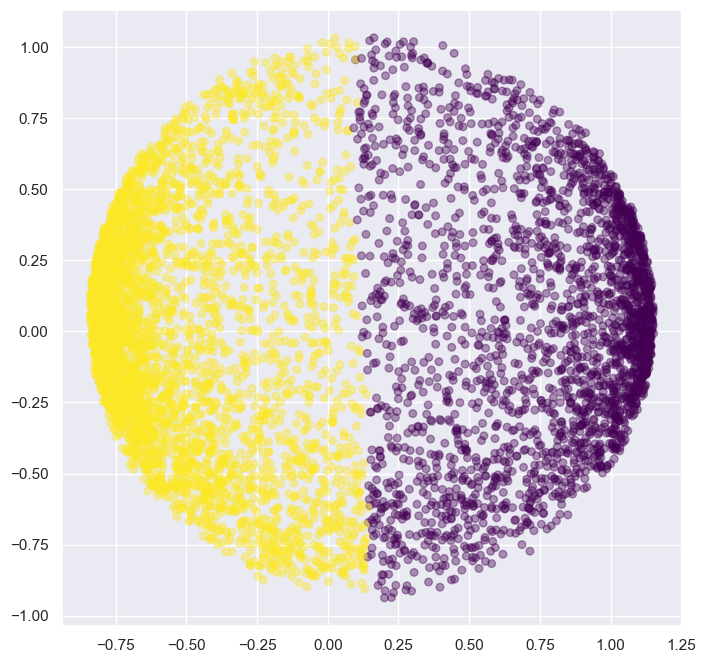

In [26]:
plt.figure(figsize=(8,8))
_ = plt.scatter(X_norm_pca[:, 0], X_norm_pca[:, 1], c=km_labels_norm, s=30, cmap='viridis', alpha=0.4)

As expected, k-means just splitted the dataset in two by the middle of the principal component. While this result may make some sense, it's likely that more than two clusters exist. We’ll proceed by analyzing additional clusters below.

Next, we’ll inspect various cluster sizes to see if K-means can produce more meaningful results. Let's plot this for both normalized and unnormalized data.

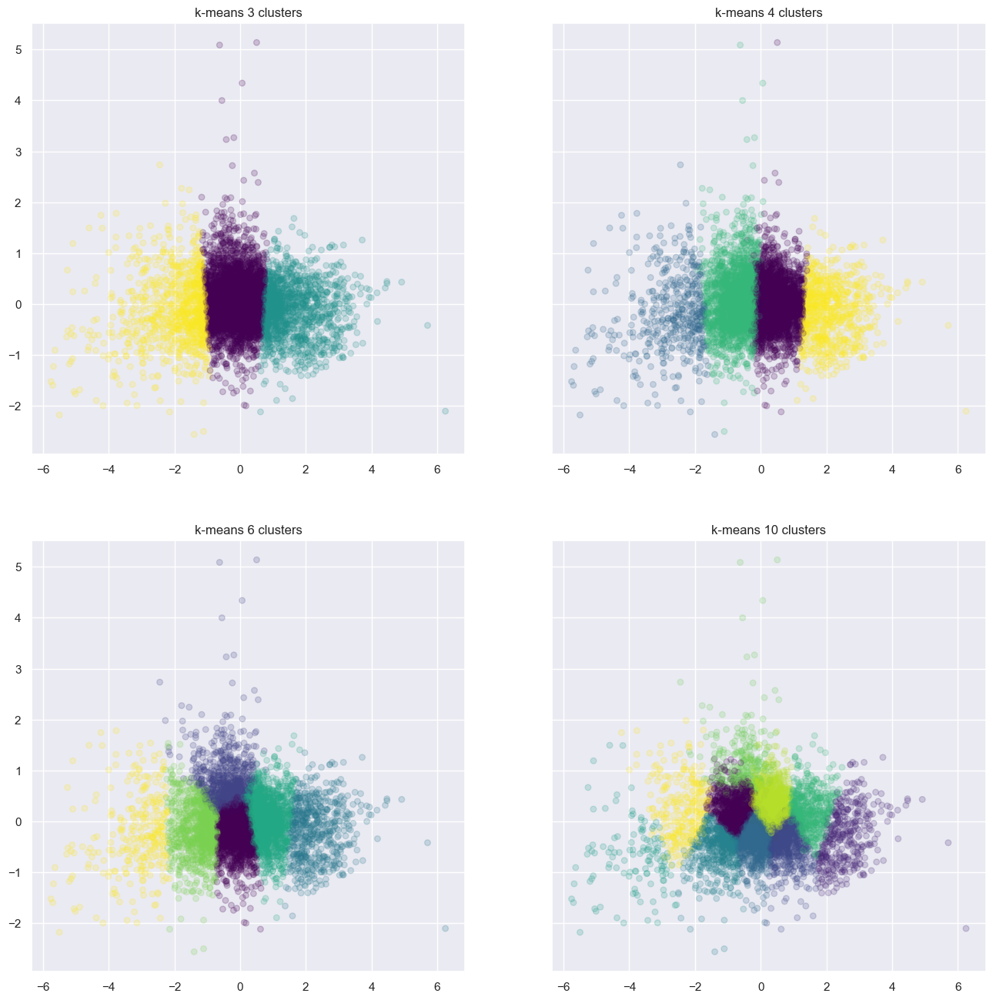

In [27]:
f, plts = plt.subplots(2, 2, sharey=True, figsize=(16, 16))
    
for i, k in enumerate([3, 4, 6, 10]):
    model = KMeans(n_clusters=k, random_state=0).fit(X_clean)
    labels = model.predict(X_clean) 
    
    ax = plts[math.floor(i/2)][i%2]
    ax.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, s=30, cmap='viridis', alpha=0.2)
    ax.set_title('k-means ' + str(k) + ' clusters')
    
_ = plt.show()

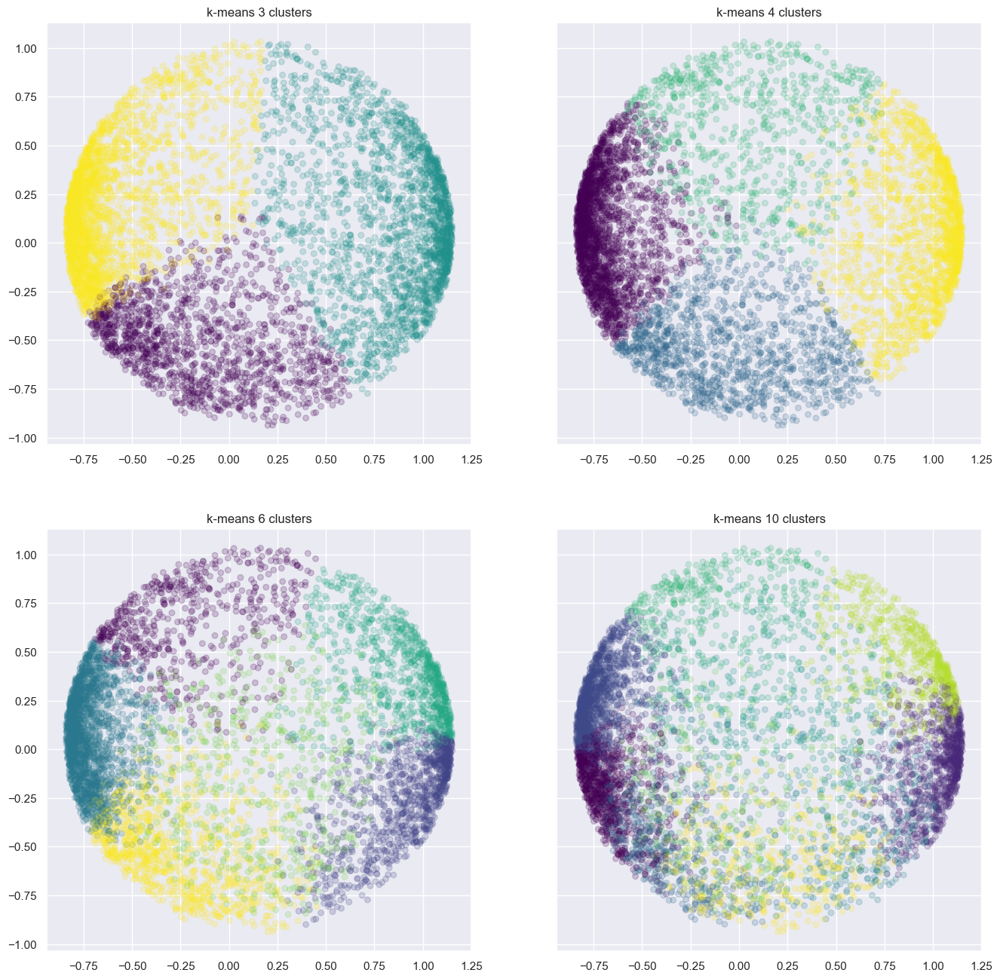

In [28]:
f, plts = plt.subplots(2, 2, sharey=True, figsize=(16, 16))
    
for i, k in enumerate([3, 4, 6, 10]):
    model = KMeans(n_clusters=k, random_state=0).fit(X_clean_norm)
    labels = model.predict(X_clean_norm) 
    
    ax = plts[math.floor(i/2)][i%2]
    ax.scatter(X_norm_pca[:, 0], X_norm_pca[:, 1], c=labels, s=30, cmap='viridis', alpha=0.2)
    ax.set_title('k-means ' + str(k) + ' clusters')
    
_ = plt.show()

When plotting clusters on normalized data, the separation between clusters becomes clearer. However, the K-means algorithm does not reveal meaningful clusters when the number of clusters exceeds two.

Next, let's see what results Gaussian Mixture Models provide

### 2.1.2 Gaussian Mixtures

In [29]:
# Helper functions
def gmm_unlabeled(X, k_values):
    qmetric = calinski_harabasz_score

    qualities = []
    models = []
    
    for k in k_values:
        model = GMM(n_components=k, random_state=0).fit(X)
        models.append(model)
        labels = model.predict(X)
        
        if k >1:
            qualities.append(qmetric(X, labels))
        else:
            qualities.append(0)
            
    best = pd.Series(qualities).idxmax()
    best_model = models[best]
    n_components = best_model.get_params()['n_components']
    
    return n_components, qualities, models

K-means suggested two clusters as the optimal number of groups. Now, let's see what the Gaussian Mixture Model reveals. We'll run the algorithm with cluster values from 1 to 20 to determine the optimal number

In [30]:
results = gmm_unlabeled(X_clean, range(1, 20))
print("Optimal Number of Clusters for unnormalized data: %i" %results[0])

Optimal Number of Clusters for unnormalized data: 5


In [31]:
results_norm = gmm_unlabeled(X_clean_norm, range(1, 20))
print("Optimal Number of Clusters for normalized data: %i" %results[0])

Optimal Number of Clusters for normalized data: 5


GMM seems to perform better with 5 clusters. Let's examine what these five clusters look like.

In [32]:
gmm = GMM(n_components=5, random_state=0).fit(X_clean)
gmm_labels = gmm.predict(X_clean)

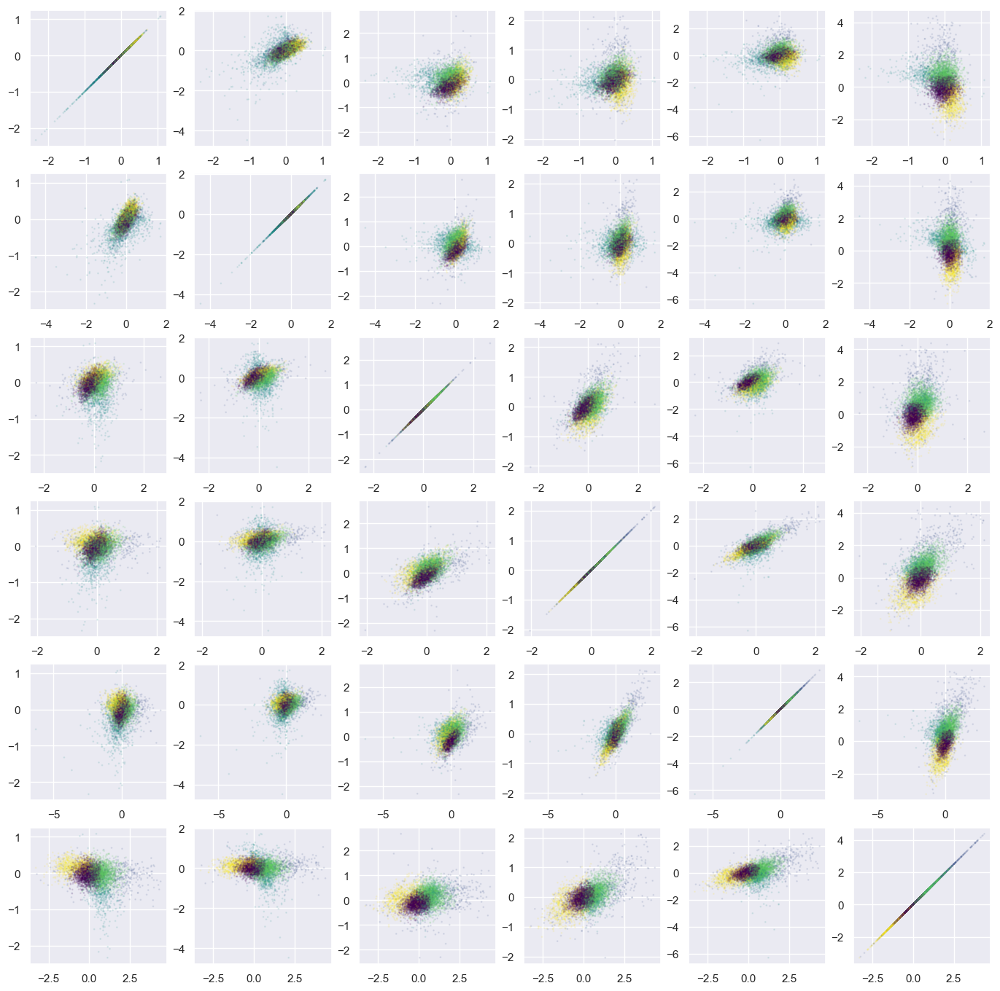

In [33]:
plot_pca_label(X_clean, gmm_labels)

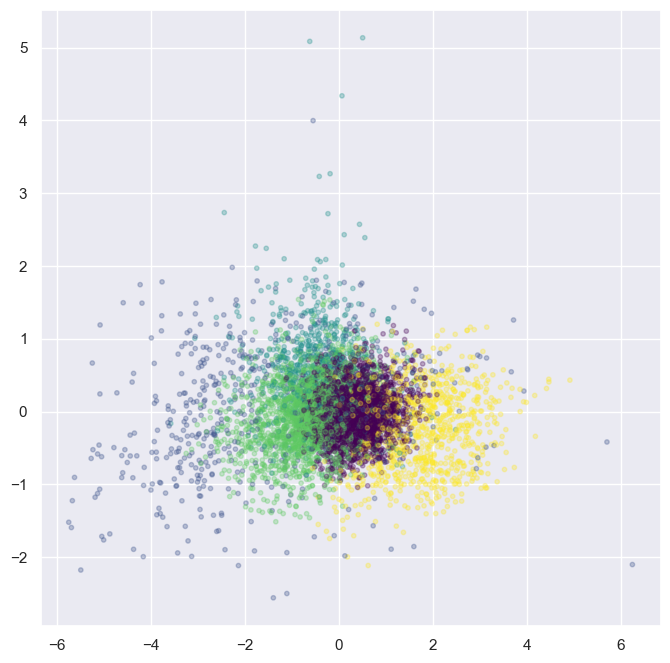

In [34]:
plt.figure(figsize=(8,8))
_ = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=gmm_labels, s=10, cmap='viridis', alpha=0.3)

Five clusters does not seen to have meaning. We will keep the original consideration of two clusters:

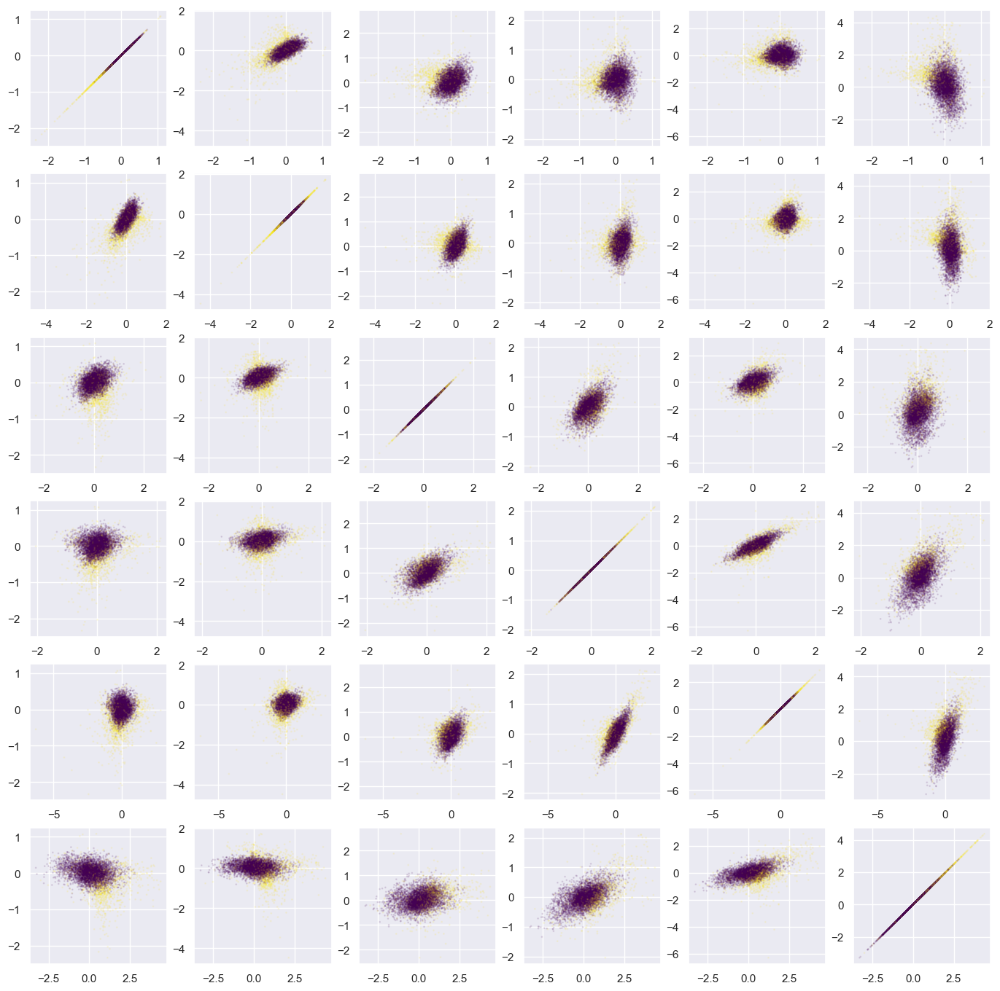

In [35]:
gmm = GMM(n_components=2, random_state=0).fit(X_clean)
gmm_labels = gmm.predict(X_clean)
plot_pca_label(X_clean, gmm_labels)

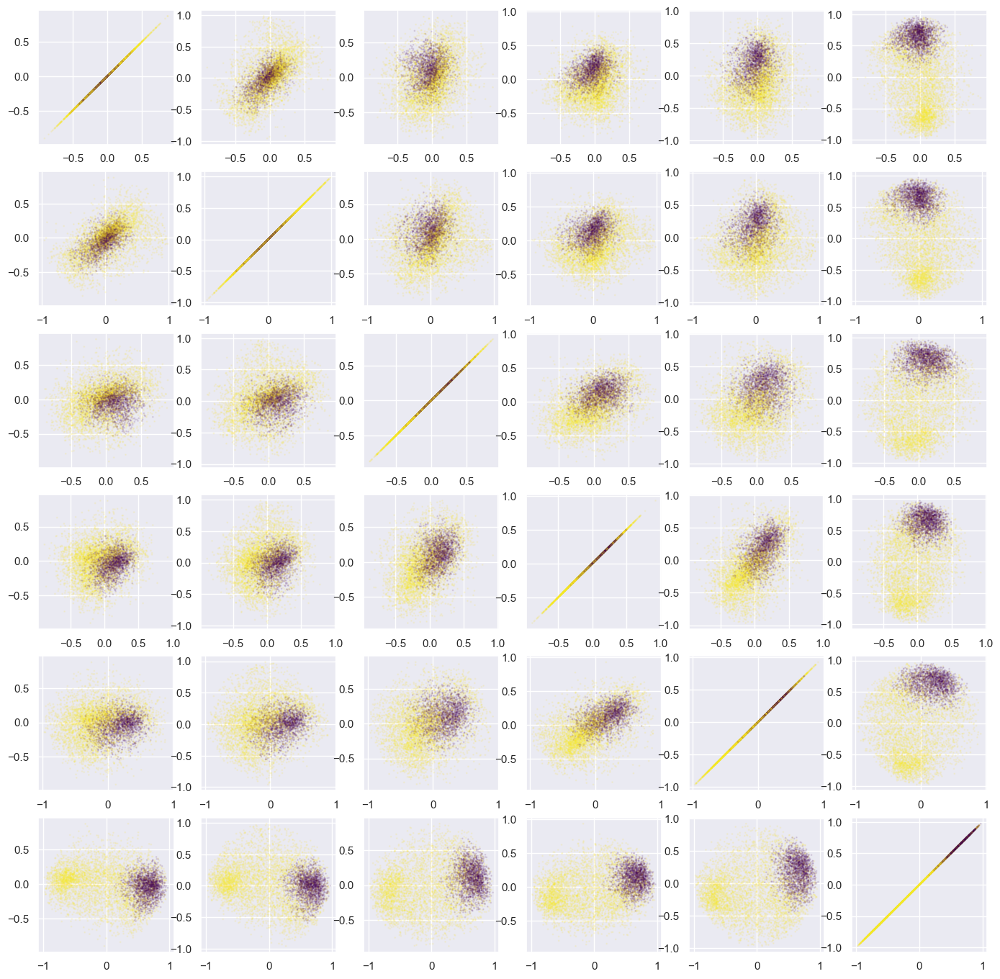

In [36]:
gmm = GMM(n_components=2, random_state=0).fit(X_clean_norm)
gmm_labels = gmm.predict(X_clean_norm)
plot_pca_label(X_clean_norm, gmm_labels)

**All the plotted examples show better results with normalized data. From now on, we will only use normalized data.**

The Gaussian Mixture model also splits the dataset into two clusters, but not along the middle. Let's try using 3 clusters; it may make sense to group the genes by the two poles and those scattered in the middle.

We'll also analyze various cluster sizes with GMM:

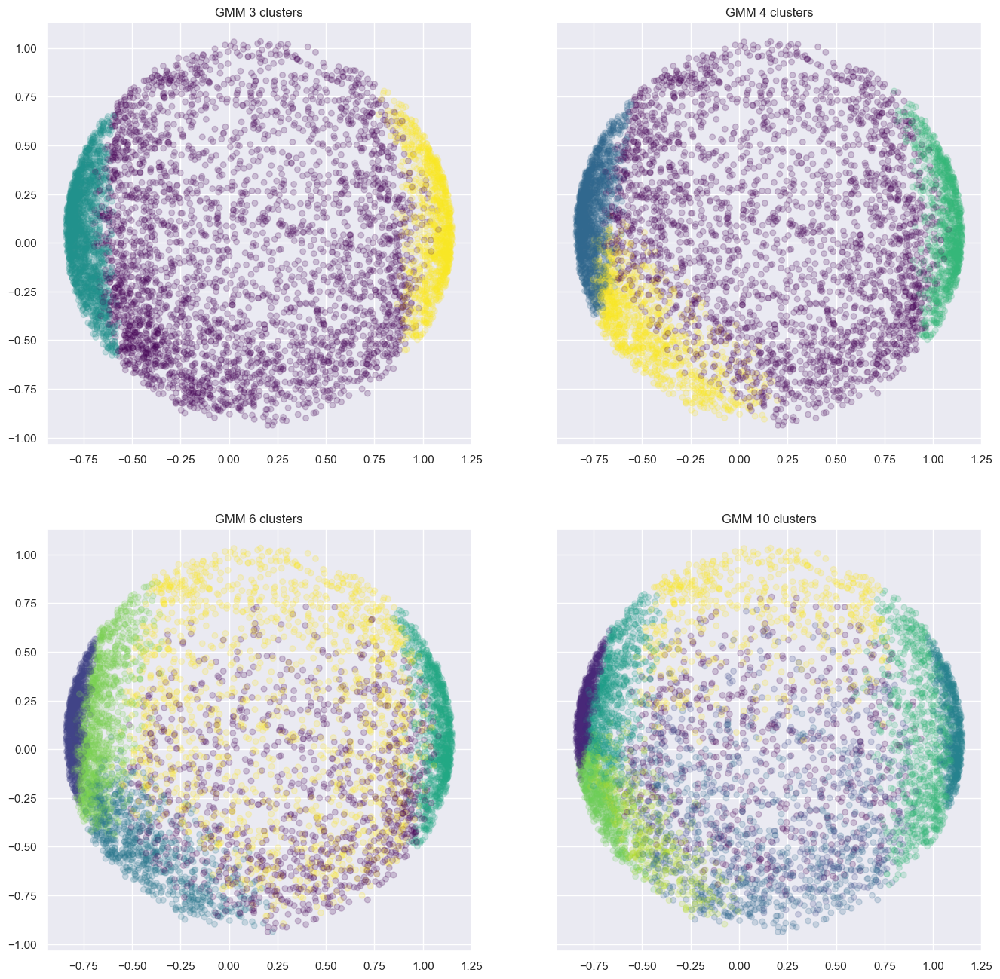

In [37]:
f, plts = plt.subplots(2, 2, sharey=True, figsize=(16, 16))
    
for i, k in enumerate([3, 4, 6, 10]):
    model = GMM(n_components=k, n_init=10, max_iter=50, random_state=0).fit(X_clean_norm)
    labels = model.predict(X_clean_norm)
    
    ax = plts[math.floor(i/2)][i%2]
    ax.scatter(X_norm_pca[:, 0], X_norm_pca[:, 1], c=labels, s=30, cmap='viridis', alpha=0.2)
    ax.set_title('GMM ' + str(k) + ' clusters')
    
_ = plt.show()

Unlike K-means, the GMM algorithm provides some meaningful results with 3 and 4 clusters. These clusters may or may not make biological sense, but for now, we will focus on analyzing the clustering results from GMM.

### 2.1.3 Analyze clusters

In [38]:
# Helpers function  
def analyze_num_clusters(k, data, pca_data, original_data, algo='GMM'):
    if algo == 'kmeans':
        model = KMeans(n_clusters=k, n_init=10, max_iter=50, random_state=0).fit(data)        
        labels = model.predict(data)
    if algo == 'ward':
        labels = AgglomerativeClustering(n_clusters=k).fit_predict(data)
    if algo == 'spectral':
        labels = SpectralClustering(n_clusters=k, assign_labels="discretize", random_state=0).fit_predict(data)
    if algo == 'birch':
        labels = Birch(branching_factor=50, n_clusters=k, threshold=0.5, compute_labels=True).fit_predict(data)
    else:
        model = GMM(n_components=k, n_init=10, max_iter=50, random_state=0).fit(data)        
        labels = model.predict(data)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    
    for label in range(0, k):
        values = original_data[labels == label]
        label_str = 'Cluster '+ str(label)
        ax1.scatter(pca_data[labels == label, 0], pca_data[labels == label, 1], s=30, cmap='viridis', alpha=0.3, label=label_str)
        ax2.plot(x_axis, np.mean(values, axis=0), label=label_str)
    
    ax1.set_title('Projection of ' + str(k) + ' clusters in PCA space')
    
    ax2.set_title('Average change on time for each cluster')
    ax2.set_ylabel('Gene expression')
    ax2.set_xlabel('Time')
    ax2.set_xticks(x_axis)
    
    plt.legend(loc='best') 
    _ = plt.show()
    return labels

def plot_clusters(df):
    fig = plt.figure(figsize=(14,6))
    values = df.values[:,1:].transpose().astype(float)

    ax = plt.subplot(1,2,1)
    plt.plot(x_axis, values)
    plt.xlabel('Time points')

    ax = plt.subplot(1,2,2)
    plt.plot(x_axis, np.mean(values, axis=1))
    plt.xticks(x_axis)
    plt.xlabel('Time points')
    plt.show()
    
def plot_cluster_examples(cluster_label, labels):
    fig = plt.figure(figsize=(14,6))
    values = X_clean[labels == cluster_label]
    examples = values[0:20]

    ax = plt.subplot(1,2,1)
    plt.plot(x_axis, np.transpose(examples))
    plt.xticks(x_axis)
    plt.xlabel('Time points')
    plt.title('Example of cluster ' + str(cluster_label))

    ax = plt.subplot(1,2,2)
    plt.plot(x_axis, np.mean(values, axis=0))
    plt.xticks(x_axis)
    plt.xlabel('Time points')
    plt.title('Mean behavior of cluster ' + str(cluster_label))

    plt.show()

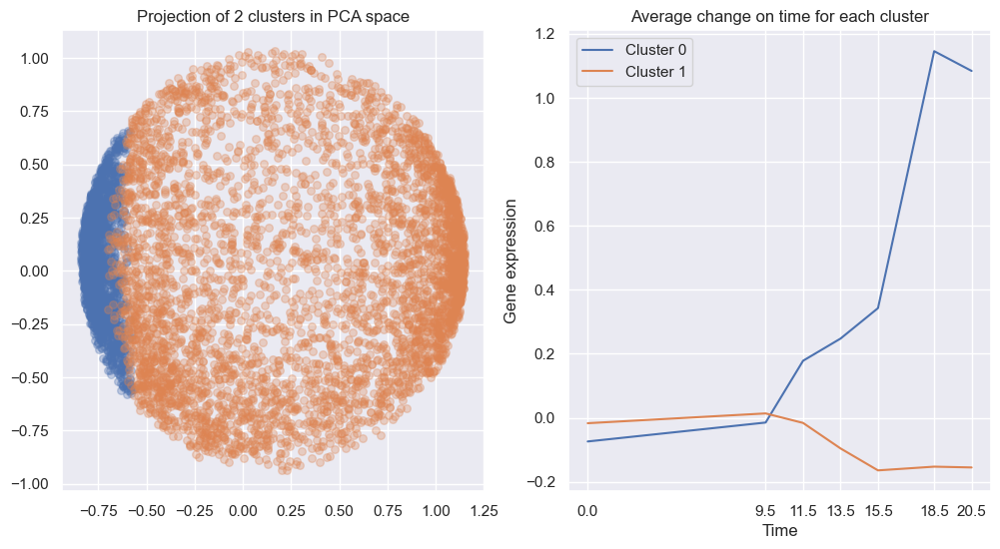

In [39]:
_ = analyze_num_clusters(2, X_clean_norm, X_norm_pca, X_clean)

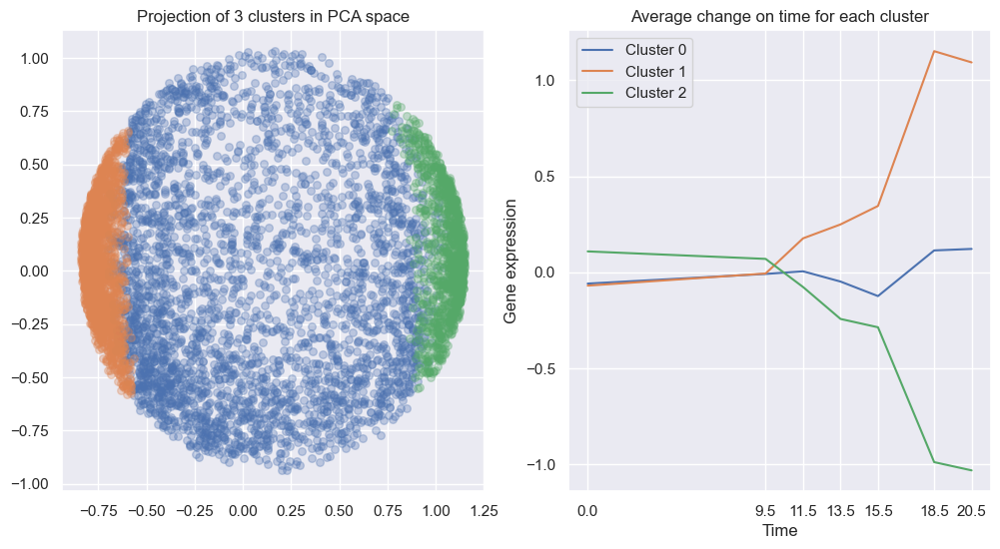

In [40]:
labels_3 = analyze_num_clusters(3, X_clean_norm, X_norm_pca, X_clean)

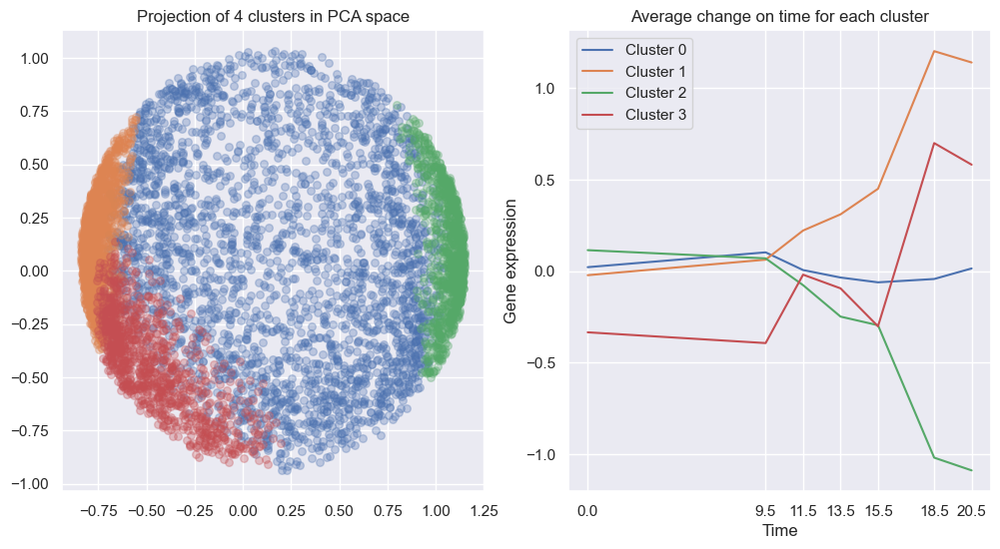

In [41]:
_ = analyze_num_clusters(4, X_clean_norm, X_norm_pca, X_clean)

It seems that the best way to cluster the data for all genes is by using **three clusters**, where we observe three distinct behaviors:
- One group increases its expression over time.
- One group remains almost unchanged.
- One group decreases its expression over time.

Let's plot some examples to see if they reflect the same patterns as the mean.

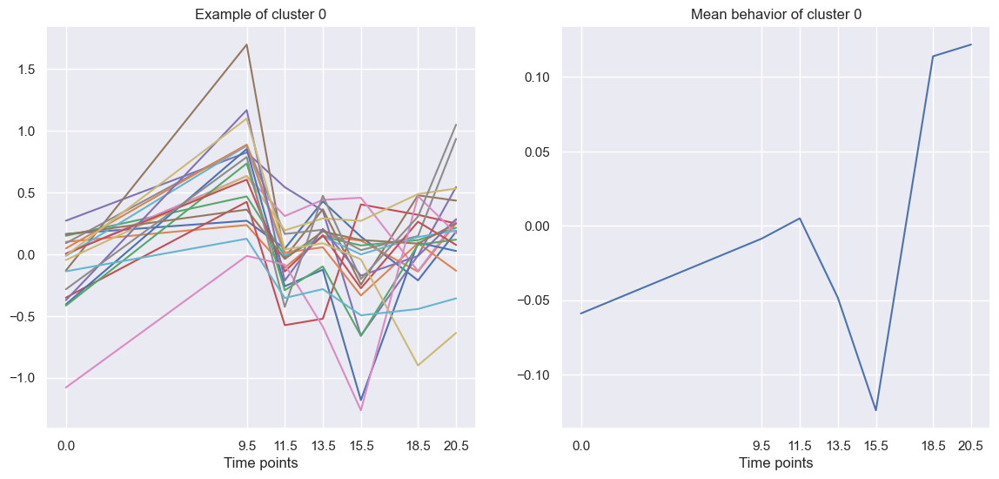

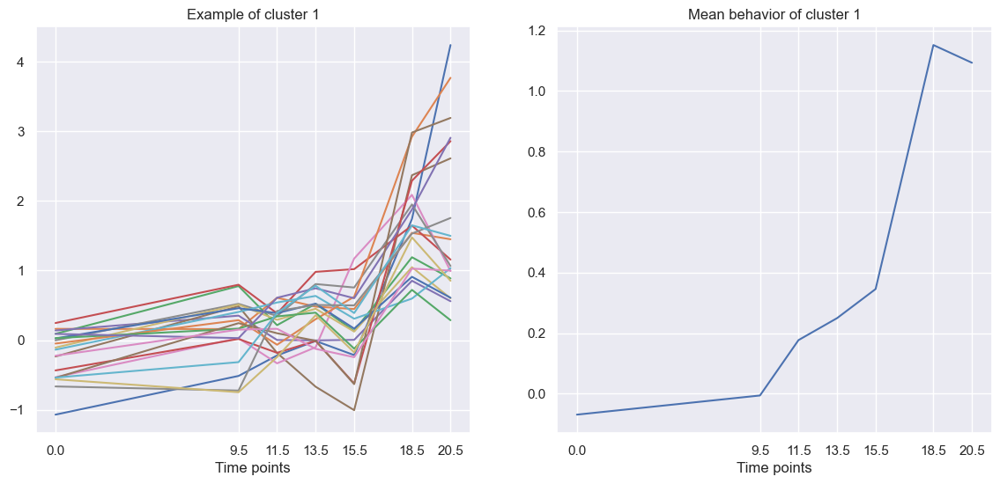

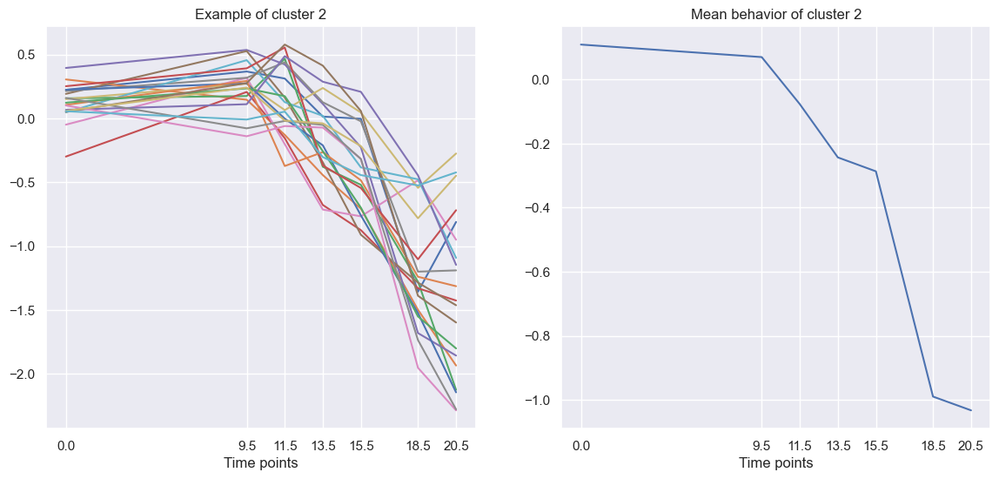

In [42]:
plot_cluster_examples(0, labels_3)
plot_cluster_examples(1, labels_3)
plot_cluster_examples(2, labels_3)

As expected, the genes within each cluster behave similarly to the cluster mean.

## 2.2 Diauxic shift

In the next step, the analysis will be repeated, focusing only on genes that are not significantly impacted by the diauxic shift. To identify these genes, a method will be applied to select the 1,000 genes most affected by the shift across the seven time-point measurements.

Diauxic shift is a type of growth behavior found in bacterias. This growth has two different phases due to the prefference of the bacteria for one over two different carbon sources. In a first stage, bacteria consumes only one of the them and grow rapidly. When this source is totally consumed, bacteria stop growing and start consuming the second source, what produce another growth stage in the bacteria population.

![shift](img/shift.png)


Plotting our dataset, we should intuit this two-stages growth:

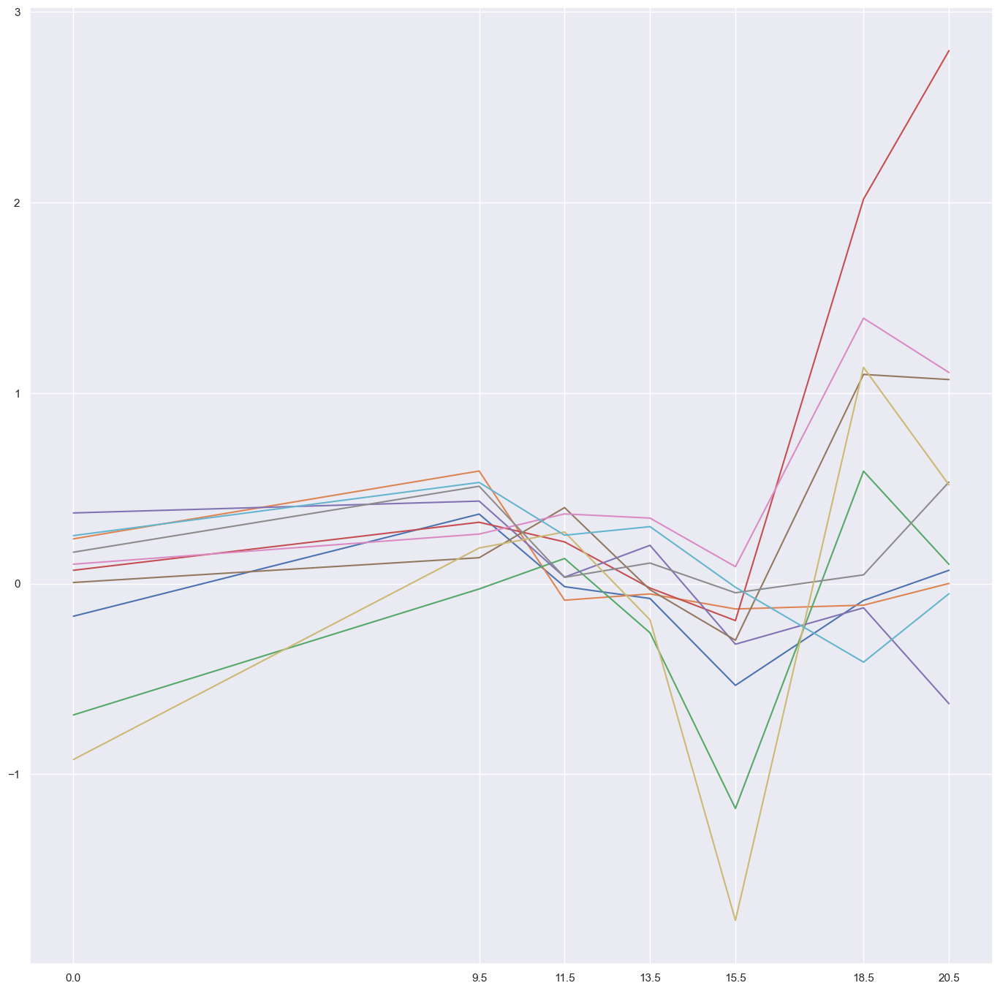

In [43]:
plt.figure(figsize=(17, 17))
plt.plot(x_axis, data.iloc[100:110,1:].transpose())
plt.xticks(x_axis)
plt.show()

In this sample, we can observe the effect of the diauxic shift on the expression of some genes. Between timepoints 13.5 and 15.5, a change in the expression progression of certain genes is noticeable.

Now, we will focus on analyzing the genes that are most affected by the diauxic shift. To do this, **we will filter out cluster 0 from the previous section**, as it shows minimal change over time. We will then calculate the absolute change at each time point and aggregate them to identify which genes change the most throughout the entire experiment.

In [44]:
df_delta = data[labels_3 != 0]
times = list(time_points.loc[0])
df_delta['total'] = 0

for t in range(0, len(times)):
    prev = times[t - 1]
    currt = times[t]
    
    if t == 0:
        df_delta[currt] = 0
    else:
        df_delta[currt] = abs(data[currt] - data[prev])
        df_delta['total'] = df_delta['total'] + df_delta[currt]

df_delta = df_delta.sort_values(by=['total'], ascending=False)
df_delta.describe()

,0.0,9.5,11.5,13.5,15.5,18.5,20.5,total
count,2862.0,2862.000000,2862.000000,2862.000000,2862.000000,2862.000000,2862.000000,2862.000000
mean,0.0,0.167754,0.282590,0.269232,0.222650,0.785583,0.391196,2.119005
std,0.0,0.155542,0.253999,0.234404,0.198193,0.558485,0.352514,0.988903
min,0.0,0.000000,0.000000,0.000000,0.000000,0.001000,0.001000,0.243000
25%,0.0,0.059000,0.106250,0.098000,0.080250,0.370000,0.146000,1.414250
50%,0.0,0.127000,0.220000,0.205000,0.175000,0.687500,0.303500,1.971500
75%,0.0,0.228000,0.378750,0.378000,0.308000,1.090750,0.545750,2.594750
max,0.0,1.394000,2.482000,2.105000,2.580000,4.211000,3.730000,9.566000


In [45]:
df_highest = data[data.index.isin(df_delta.iloc[:1000].index)]
df_highest.describe()

,0.0,9.5,11.5,13.5,15.5,18.5,20.5
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,-0.057920,-0.011627,0.140964,0.144229,0.186041,0.729305,0.653369
std,0.310481,0.369717,0.371668,0.510140,0.656519,1.588096,1.633664
min,-1.497000,-1.813000,-1.758000,-1.393000,-1.567000,-3.278000,-5.481000
25%,-0.247000,-0.209250,-0.111500,-0.143250,-0.229000,-1.014250,-0.767000
50%,-0.022500,0.016000,0.149000,0.109500,0.091000,1.168000,0.943000
75%,0.160000,0.222250,0.387250,0.392250,0.533000,1.795500,1.800750
max,0.715000,1.323000,1.889000,2.131000,2.888000,4.372000,4.354000


In [46]:
df_highest.head()

,GENES,0.0,9.5,11.5,13.5,15.5,18.5,20.5
12,'YHR007C',0.224,0.367,0.312,0.014,-0.003,-1.357,-0.811
14,'YAL054C',-1.070,-0.514,-0.220,-0.012,-0.215,1.741,4.239
27,'YAL008W',0.091,0.777,0.215,0.522,0.131,1.191,0.887
29,'YAL012W',0.157,0.175,0.467,-0.379,-0.520,-1.279,-2.125
30,'YAL026C',0.246,0.796,0.384,0.981,1.020,1.646,1.157


In [47]:
Z = df_highest.values[:,1:].astype(float)
normalizer = Normalizer()
Z_norm = normalizer.fit_transform(Z)

Now that we have identified the 1,000 genes that change the most during the diauxic shift, we will apply a clustering algorithm to this subset. First, let's follow the same procedure to determine the potential number of clusters in this new dataset.

We will begin by plotting the correlation.

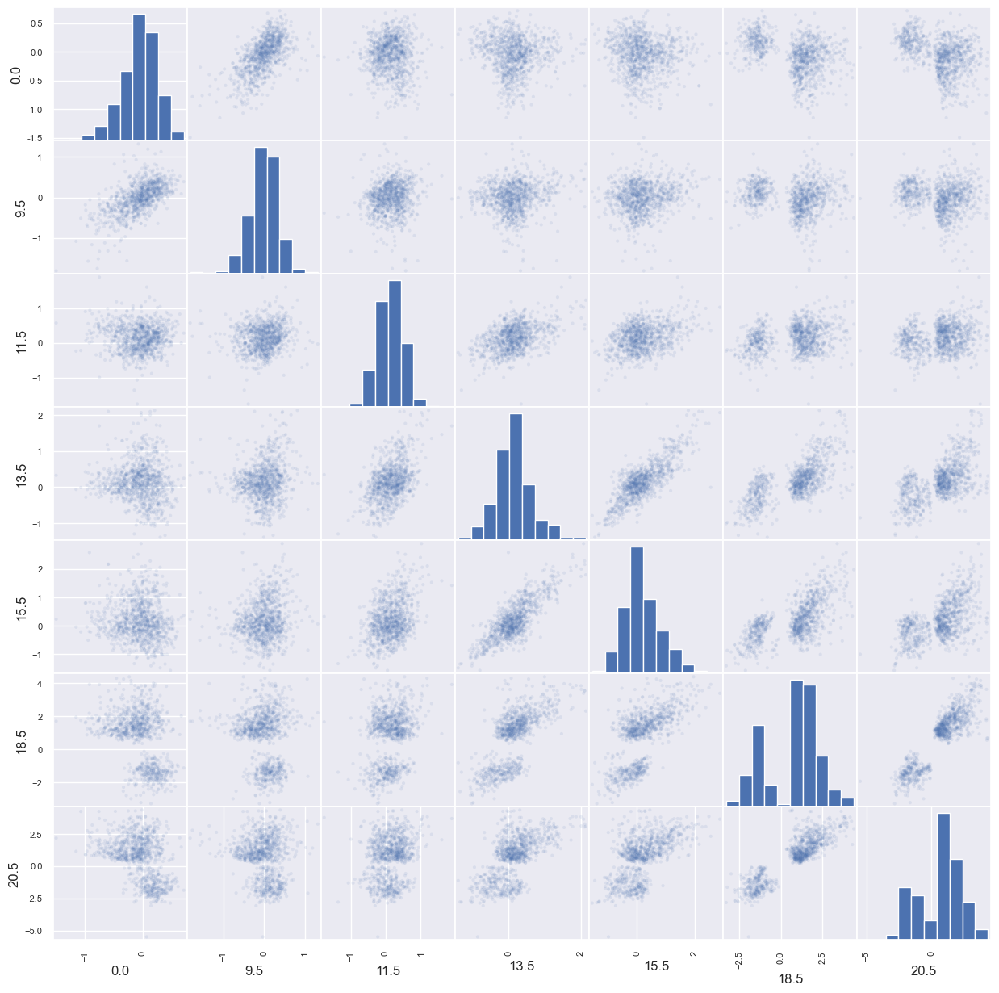

In [48]:
_ = scatter_matrix(df_highest, figsize = (15, 15), alpha=0.1)

We can clearly see two potential clusters. It is also apparent how these clusters become more differentiated as time progresses.

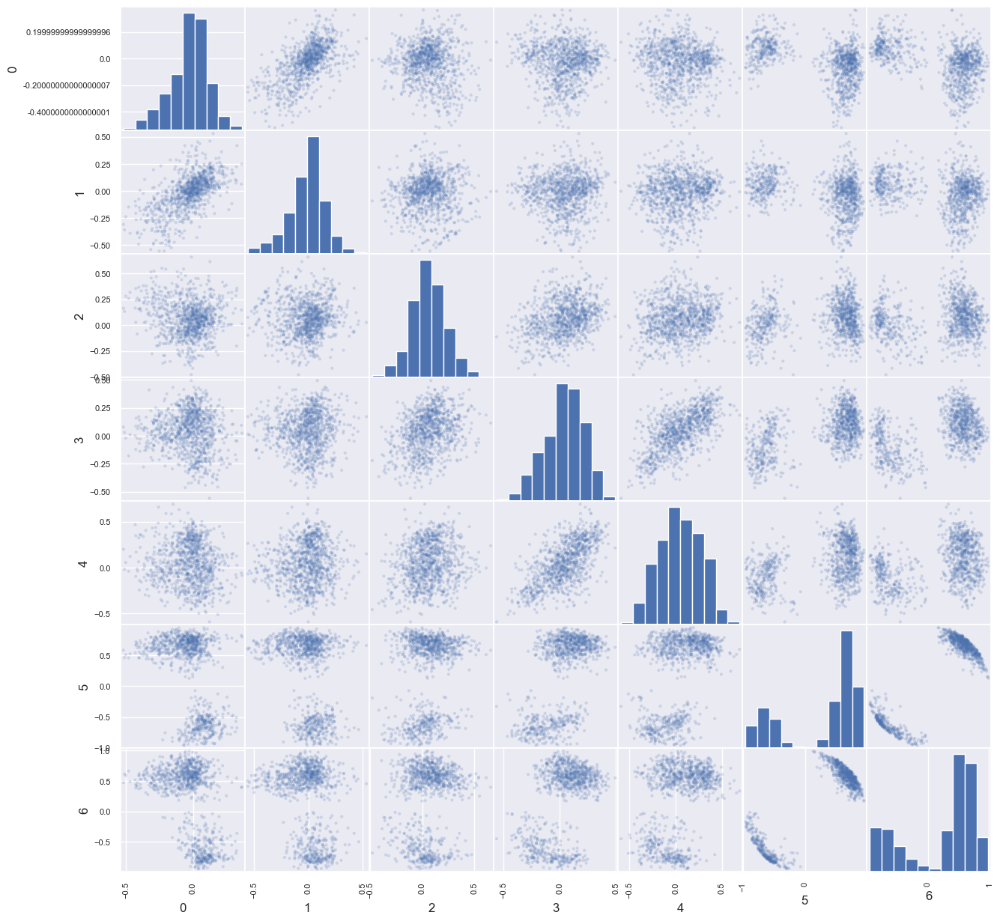

In [49]:
_ = scatter_matrix(pd.DataFrame(Z_norm), figsize = (15, 15), alpha=0.2)

The plots again show two polarized dark areas. Before clustering into 2 groups, let's apply the elbow method to see if anything changes.

In [50]:
results = kmeans_unlabeled(Z_norm, range(1, 10))

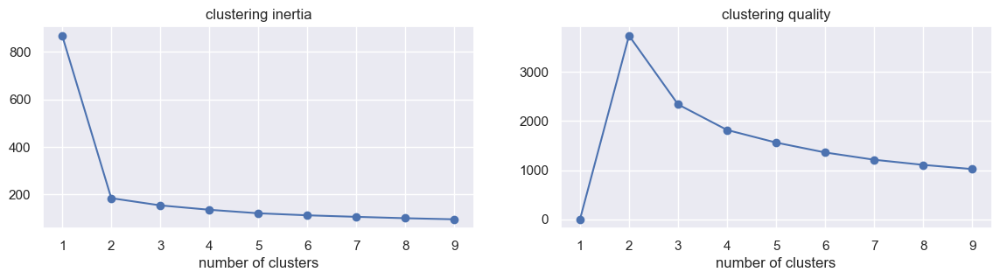

Optimal Number of Clusters for kmean: 2


In [51]:
plot_kmeans_unlabeled(results[1], results[2], range(1,10))
print("Optimal Number of Clusters for kmean: %i" %results[0])

In [52]:
results = gmm_unlabeled(Z_norm, range(1, 10))
print("Optimal Number of Clusters for GMM: %i" %results[0])

Optimal Number of Clusters for GMM: 2


As expected, two clusters are the most convenient number. We can observe how genes are overexpressed and underexpressed due to the diauxic shift.

Next, we will use PCA to project the data into a reduced space.

In [53]:
pca.fit(Z)
Z_pca = pca.transform(Z)

pca.fit(Z_norm)
Z_norm_pca = pca.transform(Z_norm)

### 2.2.1 k-means

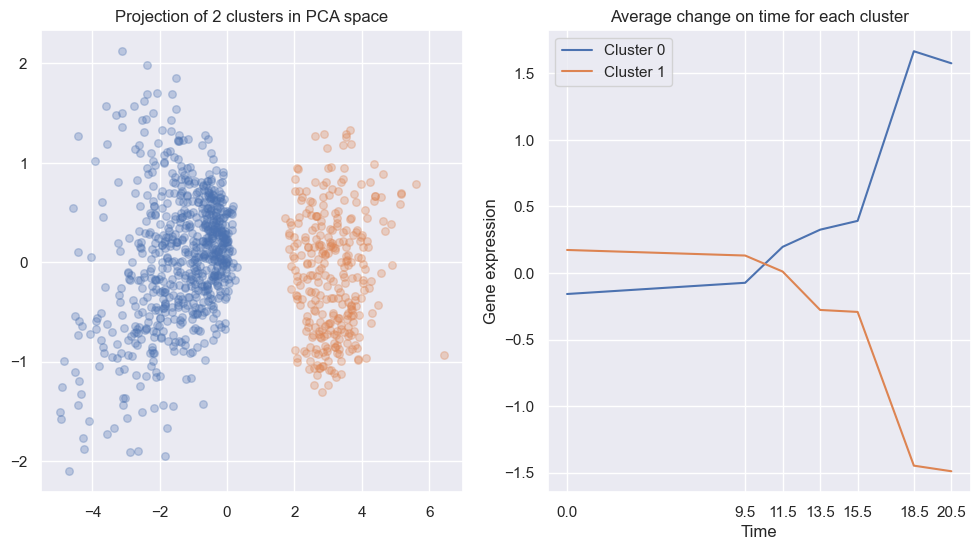

In [54]:
_ = analyze_num_clusters(2, Z, Z_pca, Z, algo='kmeans')

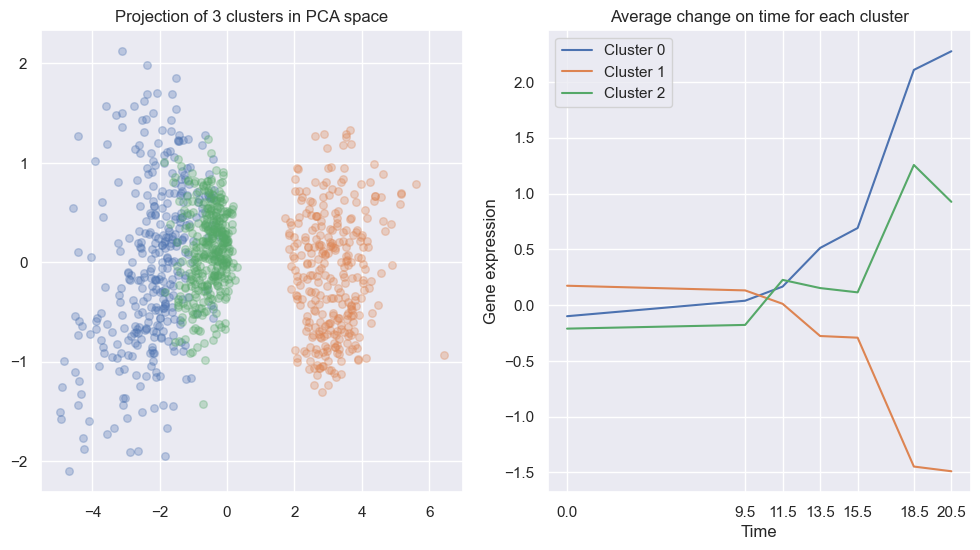

In [55]:
_ = analyze_num_clusters(3, Z, Z_pca, Z, algo='kmeans')

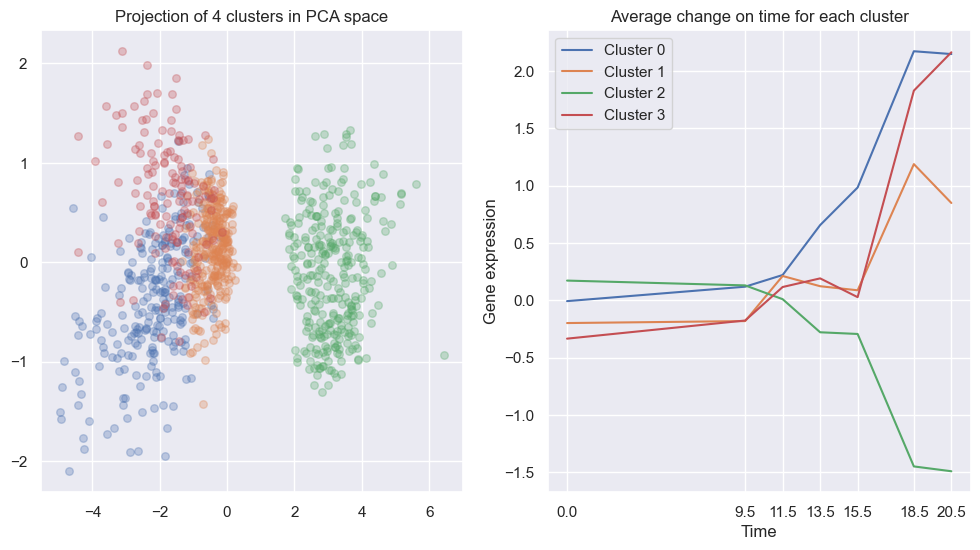

In [56]:
_ = analyze_num_clusters(4, Z, Z_pca, Z, algo='kmeans')

Clustering into 2 groups seems to be the best option. We can observe how K-means divides the dataset into two sets:

- Genes whose expression increases over time.
- Genes whose expression decreases over time.

### 2.2.2 Gaussian Mixtures

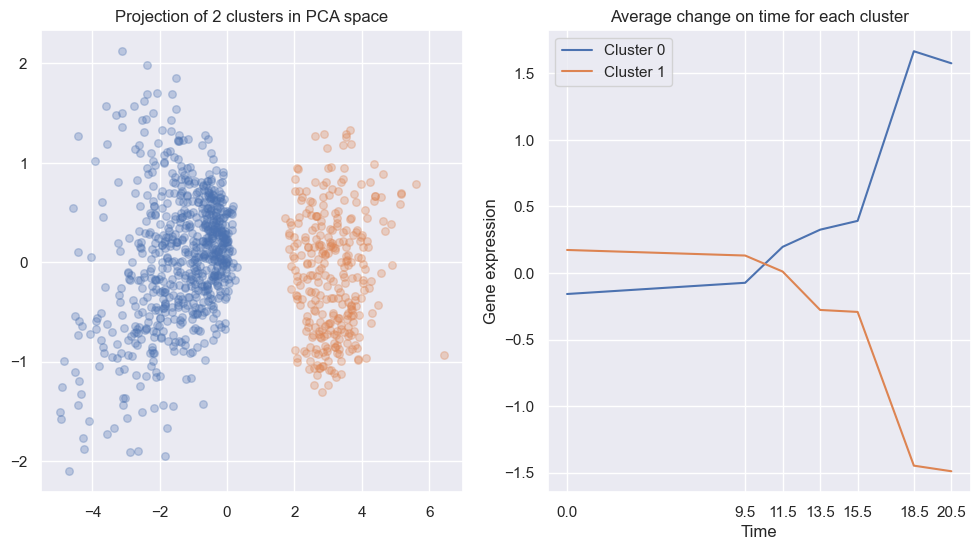

In [57]:
_ = analyze_num_clusters(2, Z, Z_pca, Z)

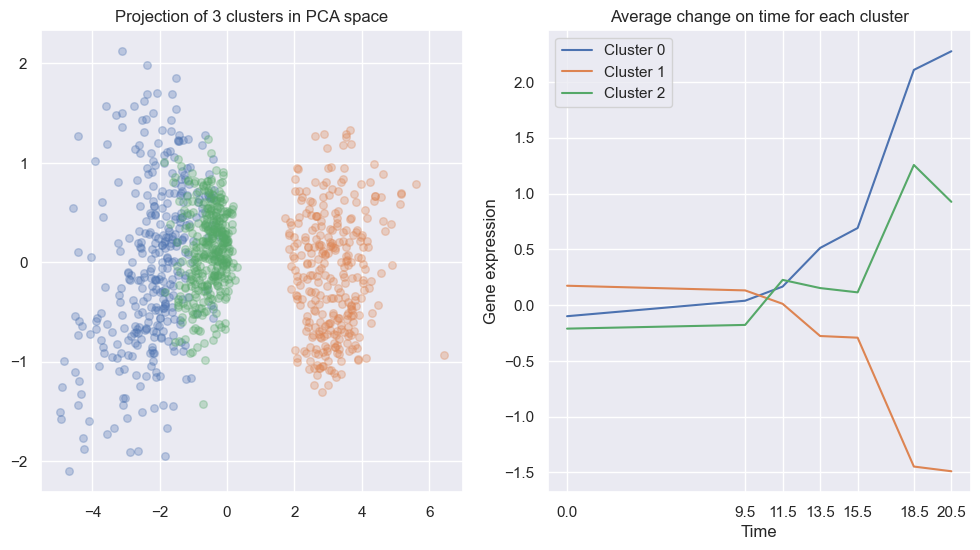

In [58]:
_ = analyze_num_clusters(3, Z, Z_pca, Z)

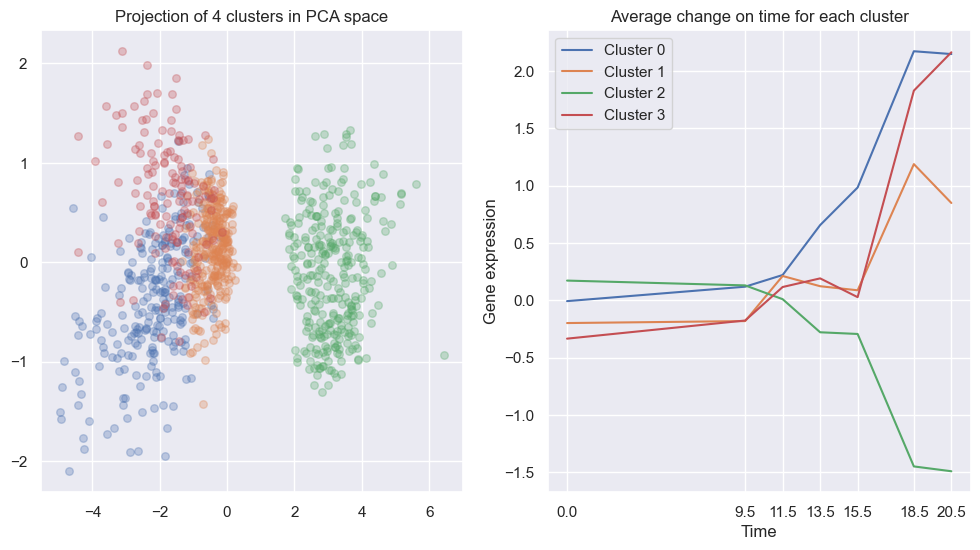

In [59]:
_ = analyze_num_clusters(4, Z, Z_pca, Z)

Gaussian Mixtures give us results similar to K-means. Clustering into 2 groups also makes sense with this algorithm.

### 2.2.3 Analyze the results

A plot of the median for each group may highlight whether the clustering we obtained makes sense.

In [60]:
analysis_model = GMM(n_components=2, random_state=0).fit(Z)
analysis_labels = analysis_model.predict(Z)

In [61]:
df_highest_labeled = df_highest.copy()
df_highest_labeled['label'] = analysis_labels

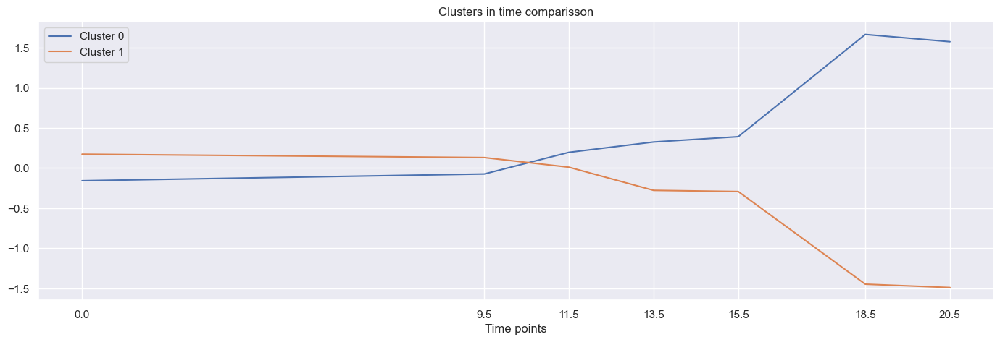

In [62]:
group0 = df_highest_labeled[df_highest_labeled['label'] == 0].transpose()[1:-1].values.astype(float)
group1 = df_highest_labeled[df_highest_labeled['label'] == 1].transpose()[1:-1].values.astype(float)
x_axis = list(time_points.loc[0])

plt.figure(figsize=(17,5))
plt.plot(x_axis, np.mean(group0, axis=1), label="Cluster 0")
plt.plot(x_axis, np.mean(group1, axis=1), label="Cluster 1")
plt.title('Clusters in time comparisson')
plt.xlabel('Time points')
plt.xticks(x_axis)
plt.legend(loc='best')
plt.show()

Let's analyze group by group:

In [63]:
df_group_0 = df_highest_labeled[df_highest_labeled['label'] == 0].iloc[:,:-1]
df_group_1 = df_highest_labeled[df_highest_labeled['label'] == 1].iloc[:,:-1]

In [64]:
df_group_0.describe()

,0.0,9.5,11.5,13.5,15.5,18.5,20.5
count,699.000000,699.000000,699.000000,699.000000,699.000000,699.000000,699.000000
mean,-0.157521,-0.073260,0.196800,0.325794,0.391976,1.666609,1.576103
std,0.298949,0.395983,0.370928,0.444146,0.630574,0.752067,0.878191
min,-1.497000,-1.813000,-1.758000,-0.669000,-1.006000,0.344000,0.205000
25%,-0.339000,-0.314000,-0.067500,0.021000,-0.085000,1.128500,0.873500
50%,-0.121000,-0.056000,0.210000,0.245000,0.293000,1.528000,1.382000
75%,0.038000,0.175000,0.447000,0.492500,0.800500,2.031500,2.148500
max,0.672000,1.323000,1.889000,2.131000,2.888000,4.372000,4.354000


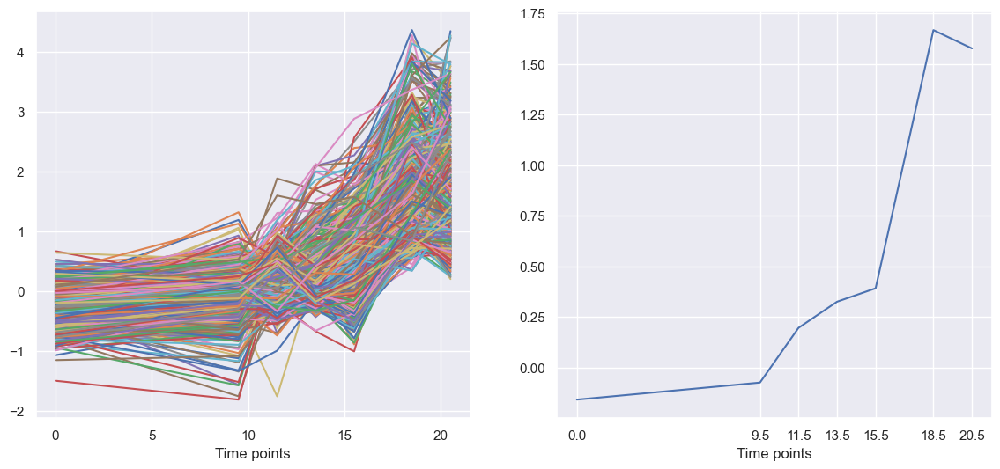

In [65]:
plot_clusters(df_group_0)

In [66]:
df_group_1.describe()

,0.0,9.5,11.5,13.5,15.5,18.5,20.5
count,301.000000,301.000000,301.000000,301.000000,301.000000,301.000000,301.000000
mean,0.173379,0.131502,0.011299,-0.277412,-0.292193,-1.447359,-1.489458
std,0.190472,0.246876,0.340210,0.390452,0.426458,0.530840,0.708564
min,-0.333000,-0.758000,-1.359000,-1.393000,-1.567000,-3.278000,-5.481000
25%,0.054000,-0.018000,-0.213000,-0.550000,-0.592000,-1.772000,-1.988000
50%,0.176000,0.134000,0.033000,-0.271000,-0.234000,-1.415000,-1.568000
75%,0.283000,0.325000,0.240000,0.040000,0.044000,-1.120000,-1.029000
max,0.715000,1.080000,0.839000,0.572000,0.902000,-0.127000,-0.022000


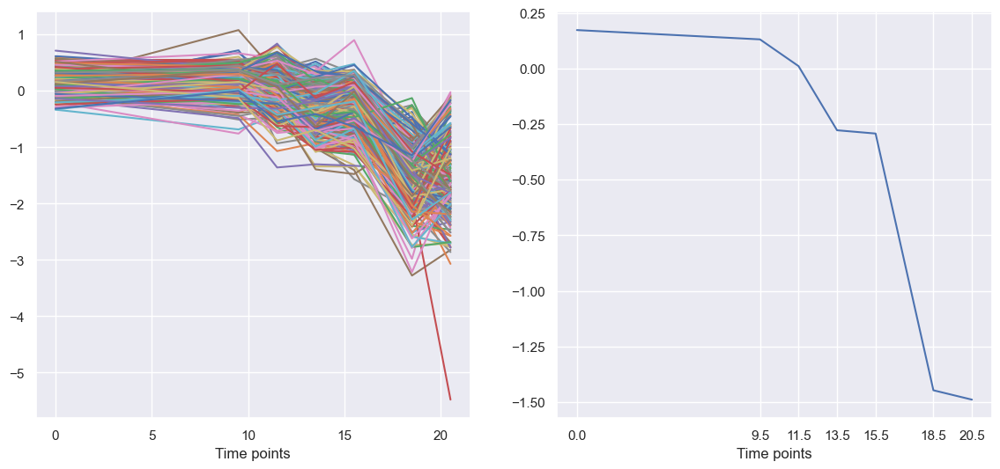

In [67]:
plot_clusters(df_group_1)

By plotting the expression of the genes in each cluster, we can observe that they exhibit the same behavior as the mean. One cluster shows an increase in gene expression after the diauxic shift (around timepoints 9.5 and 15.5), while the opposite occurs in the other cluster.

## 2.3 Other algorithms

### 2.3.1 Ward algorithm

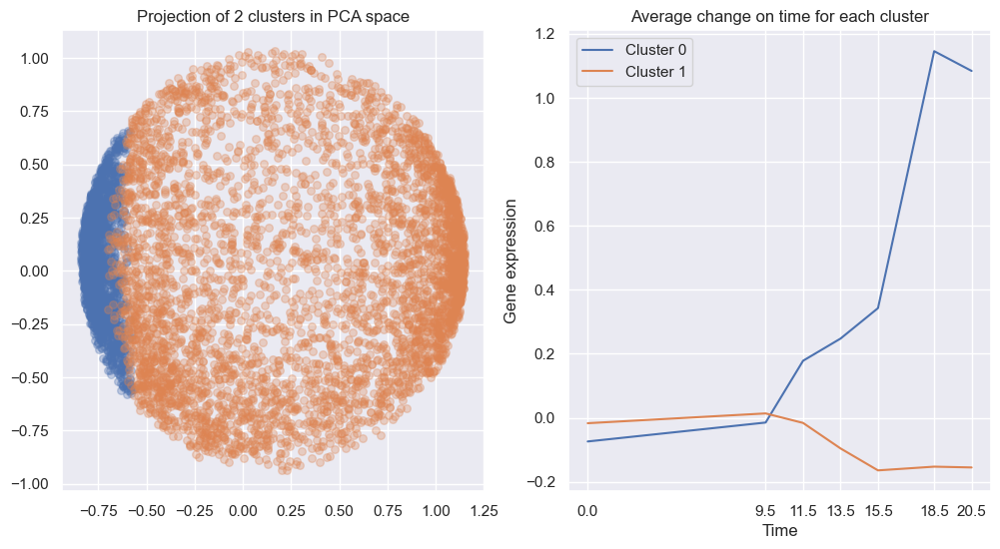

In [68]:
labels_ward_2 = analyze_num_clusters(2, X_clean_norm, X_norm_pca, X_clean, algo='ward')
df = pd.DataFrame(X_clean)
df['label'] = labels_ward_2
df_0 = df[labels_ward_2 == 0]
df_1 = df[labels_ward_2 == 1]

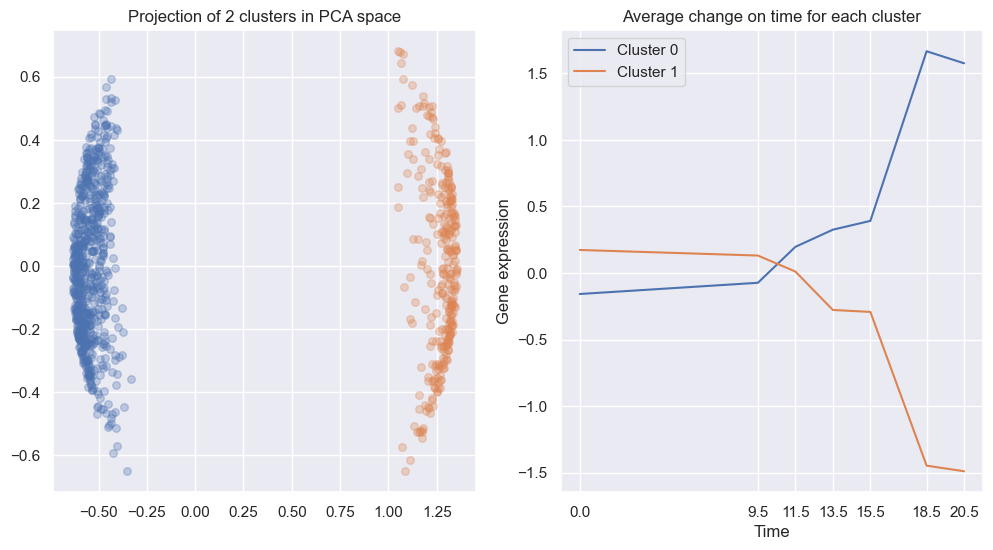

In [69]:
_ = analyze_num_clusters(2, Z_norm, Z_norm_pca, Z, algo='ward')

### 2.3.2 Birch

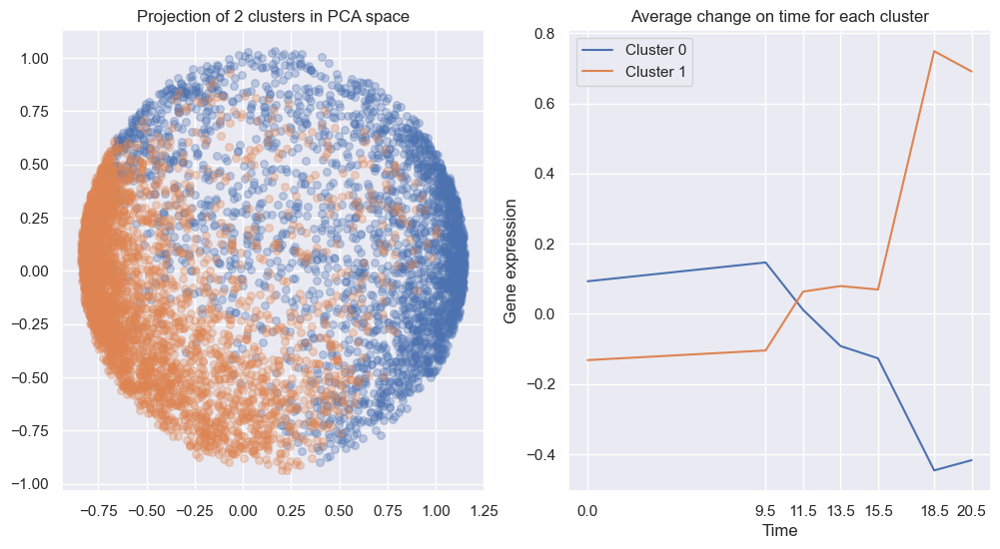

In [70]:
_ = analyze_num_clusters(2, X_clean_norm, X_norm_pca, X_clean, algo='birch')

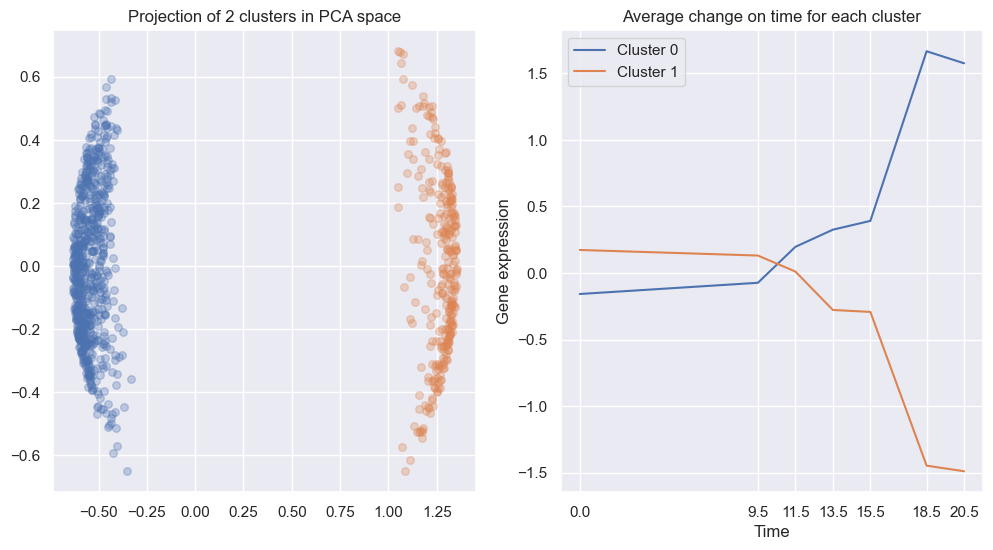

In [71]:
_ = analyze_num_clusters(2, Z_norm, Z_norm_pca, Z, algo='birch')

## 2.4 Conclussions

We applied other algorithms to see if better results could be achieved. We found that Ward and GMM produced similar results. Before filtering the most affected genes, Ward generated one large cluster where gene expression appears to remain constant over time, and a smaller cluster where gene expression increases. After filtering, the results were consistent with those of the other algorithms, with one cluster showing an increase in gene expression and the other showing a decrease.

On the other hand, Birch seemed to group the genes into two clusters more effectively before filtering. We observed a more differentiated expression within each cluster, with one group showing an increase in expression and the other showing a decrease. These results were similar to those obtained after filtering. Once the most affected genes were filtered, the results were again comparable to those of the other methods applied.

From this, we can conclude that before filtering, the genes can be grouped into three clusters: one for genes increasing their expression, one for genes decreasing their expression, and one for genes that do not show significant changes over time.

After filtering the data, it seems that the optimal number of clusters is two. By grouping the genes that reduce and increase their expression over time, after being able to remove those genes that do not change over time. 

Overall, the method that seems to work best for two clusters with the full dataset is Birch. Once the data is filtered, all methods perform well.